# 1.Импортируем библиотеки

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
import plotly.express as px
import tensorflow as tf
import sklearn


In [2]:
from pandas import read_excel, DataFrame, Series
from scipy import stats
from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error, mean_absolute_error
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from matplotlib.gridspec import GridSpec

from pandas import read_excel, DataFrame, Series
from numpy.random import seed

from tensorflow import keras as keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization, Activation

from scikeras.wrappers import KerasClassifier, KerasRegressor
from tensorflow.keras.models import Sequential
from numpy.random import seed

%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

## 2. Загрузка данных из файлов Excel

In [4]:
# Задать путь к файлам Excel
df_bp = pd.read_excel('/Users/macbook/Desktop/Информатика/Бауманские данные/ВКР/Датасет для ВКР_композиты/X_bp.xlsx')
df_bp.head()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0
1,1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0
2,2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0
3,3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0
4,4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0


In [6]:
df_nup = pd.read_excel('/Users/macbook/Desktop/Информатика/Бауманские данные/ВКР/Датасет для ВКР_композиты/X_nup.xlsx')
df_nup.head()

,Unnamed: 0,"Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,0,0,4.0,57.0
1,1,0,4.0,60.0
2,2,0,4.0,70.0
3,3,0,5.0,47.0
4,4,0,5.0,57.0


## 3. Удаление неинформативных столбцов 'Unnamed'

In [7]:
#Проверяем есть ли неинформативные столбцы в таблице X_bp и удаляем их
df_bp.drop(['Unnamed: 0'], axis=1, inplace=True)

In [8]:
df_bp.shape

(1023, 10)

In [9]:
df_bp.head()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0
1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0
2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0
3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0
4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0


In [10]:
#Проверяем есть ли неинформативные столбцы в таблице X_nup и удаляем их
df_nup.drop(['Unnamed: 0'], axis=1, inplace=True)

In [11]:
df_nup.shape

(1040, 3)

In [12]:
df_nup.head()

,"Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,0,4.0,57.0
1,0,4.0,60.0
2,0,4.0,70.0
3,0,5.0,47.0
4,0,5.0,57.0


## 4. Объединим по индексу, тип объединения INNER, смотрим итоговый датасет

In [13]:
# Датасеты имеют разный объем строк.
# Соберем исходные данные файлы в единый датасет.
# По условию задачи объединяем их по типу INNER.
df = df_bp.merge(df_nup, left_index = True, right_index = True, how = 'inner')
df.head().T

,0,1,2,3,4
Соотношение матрица-наполнитель,1.857143,1.857143,1.857143,1.857143,2.771331
"Плотность, кг/м3",2030.000000,2030.000000,2030.000000,2030.000000,2030.000000
"модуль упругости, ГПа",738.736842,738.736842,738.736842,738.736842,753.000000
"Количество отвердителя, м.%",30.000000,50.000000,49.900000,129.000000,111.860000
"Содержание эпоксидных групп,%_2",22.267857,23.750000,33.000000,21.250000,22.267857
"Температура вспышки, С_2",100.000000,284.615385,284.615385,300.000000,284.615385
"Поверхностная плотность, г/м2",210.000000,210.000000,210.000000,210.000000,210.000000
"Модуль упругости при растяжении, ГПа",70.000000,70.000000,70.000000,70.000000,70.000000
"Прочность при растяжении, МПа",3000.000000,3000.000000,3000.000000,3000.000000,3000.000000
"Потребление смолы, г/м2",220.000000,220.000000,220.000000,220.000000,220.000000


In [14]:
#Посмотрим количество колонок и столбцов
df.shape
# Итоговый датасет имеет 13 столбцов и 1023 строки, 17 строк из таблицы X_nup были удалены.

(1023, 13)

In [15]:
# Просмотрим датасет
df

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,1.857143,2030.000000,738.736842,30.000000,22.267857,100.000000,210.000000,70.000000,3000.000000,220.000000,0,4.000000,57.000000
1,1.857143,2030.000000,738.736842,50.000000,23.750000,284.615385,210.000000,70.000000,3000.000000,220.000000,0,4.000000,60.000000
2,1.857143,2030.000000,738.736842,49.900000,33.000000,284.615385,210.000000,70.000000,3000.000000,220.000000,0,4.000000,70.000000
3,1.857143,2030.000000,738.736842,129.000000,21.250000,300.000000,210.000000,70.000000,3000.000000,220.000000,0,5.000000,47.000000
4,2.771331,2030.000000,753.000000,111.860000,22.267857,284.615385,210.000000,70.000000,3000.000000,220.000000,0,5.000000,57.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018,2.271346,1952.087902,912.855545,86.992183,20.123249,324.774576,209.198700,73.090961,2387.292495,125.007669,90,9.076380,47.019770
1019,3.444022,2050.089171,444.732634,145.981978,19.599769,254.215401,350.660830,72.920827,2360.392784,117.730099,90,10.565614,53.750790
1020,3.280604,1972.372865,416.836524,110.533477,23.957502,248.423047,740.142791,74.734344,2662.906040,236.606764,90,4.161154,67.629684
1021,3.705351,2066.799773,741.475517,141.397963,19.246945,275.779840,641.468152,74.042708,2071.715856,197.126067,90,6.313201,58.261074


In [16]:
#Просмотрим информацию о датасете, проверим тип данных в каждом столбце (типы признаков)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1023 entries, 0 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       1023 non-null   float64
 1   Плотность, кг/м3                      1023 non-null   float64
 2   модуль упругости, ГПа                 1023 non-null   float64
 3   Количество отвердителя, м.%           1023 non-null   float64
 4   Содержание эпоксидных групп,%_2       1023 non-null   float64
 5   Температура вспышки, С_2              1023 non-null   float64
 6   Поверхностная плотность, г/м2         1023 non-null   float64
 7   Модуль упругости при растяжении, ГПа  1023 non-null   float64
 8   Прочность при растяжении, МПа         1023 non-null   float64
 9   Потребление смолы, г/м2               1023 non-null   float64
 10  Угол нашивки, град                    1023 non-null   int64  
 11  Шаг нашивки           

In [17]:
# Сохраним итоговый датасет
df.to_excel("Final_dataset.xlsx")

# Проведем разведочный анализ данных (получить среднее, медианное значение,  проверить наличие пропусков, провести анализ и исключение выбросов.)

In [18]:
df.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
count,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000
mean,2.930366,1975.734888,739.923233,110.570769,22.244390,285.882151,482.731833,73.328571,2466.922843,218.423144,44.252199,6.899222,57.153929
std,0.913222,73.729231,330.231581,28.295911,2.406301,40.943260,281.314690,3.118983,485.628006,59.735931,45.015793,2.563467,12.350969
min,0.389403,1731.764635,2.436909,17.740275,14.254985,100.000000,0.603740,64.054061,1036.856605,33.803026,0.000000,0.000000,0.000000
25%,2.317887,1924.155467,500.047452,92.443497,20.608034,259.066528,266.816645,71.245018,2135.850448,179.627520,0.000000,5.080033,49.799212
50%,2.906878,1977.621657,739.664328,110.564840,22.230744,285.896812,451.864365,73.268805,2459.524526,219.198882,0.000000,6.916144,57.341920
75%,3.552660,2021.374375,961.812526,129.730366,23.961934,313.002106,693.225017,75.356612,2767.193119,257.481724,90.000000,8.586293,64.944961
max,5.591742,2207.773481,1911.536477,198.953207,33.000000,413.273418,1399.542362,82.682051,3848.436732,414.590628,90.000000,14.440522,103.988901


## Посмотрим средние значения

In [19]:
df.mean()

Соотношение матрица-наполнитель            2.930366
Плотность, кг/м3                        1975.734888
модуль упругости, ГПа                    739.923233
Количество отвердителя, м.%              110.570769
Содержание эпоксидных групп,%_2           22.244390
Температура вспышки, С_2                 285.882151
Поверхностная плотность, г/м2            482.731833
Модуль упругости при растяжении, ГПа      73.328571
Прочность при растяжении, МПа           2466.922843
Потребление смолы, г/м2                  218.423144
Угол нашивки, град                        44.252199
Шаг нашивки                                6.899222
Плотность нашивки                         57.153929
dtype: float64

## Посмотрим медианные значения

In [20]:
df.median()

Соотношение матрица-наполнитель            2.906878
Плотность, кг/м3                        1977.621657
модуль упругости, ГПа                    739.664328
Количество отвердителя, м.%              110.564840
Содержание эпоксидных групп,%_2           22.230744
Температура вспышки, С_2                 285.896812
Поверхностная плотность, г/м2            451.864365
Модуль упругости при растяжении, ГПа      73.268805
Прочность при растяжении, МПа           2459.524526
Потребление смолы, г/м2                  219.198882
Угол нашивки, град                         0.000000
Шаг нашивки                                6.916144
Плотность нашивки                         57.341920
dtype: float64

## Получим среднее и медианное значения данных в колонках

In [21]:
mean_and_50 = df.describe()
mean_and_50.loc[['mean', '50%']]

#значения в основном схожи

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
mean,2.930366,1975.734888,739.923233,110.570769,22.244390,285.882151,482.731833,73.328571,2466.922843,218.423144,44.252199,6.899222,57.153929
50%,2.906878,1977.621657,739.664328,110.564840,22.230744,285.896812,451.864365,73.268805,2459.524526,219.198882,0.000000,6.916144,57.341920


## Проверим на пропущенные данные

In [22]:
df.isnull().sum()
# Пропущенных данных нет = нулевых значений нет, очистка не требуется

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки, град                      0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

## Проверим датасет на дубликаты


In [23]:
df.duplicated().sum()
#Дубликатов нет

0

## Гистограммы распределения каждой переменной

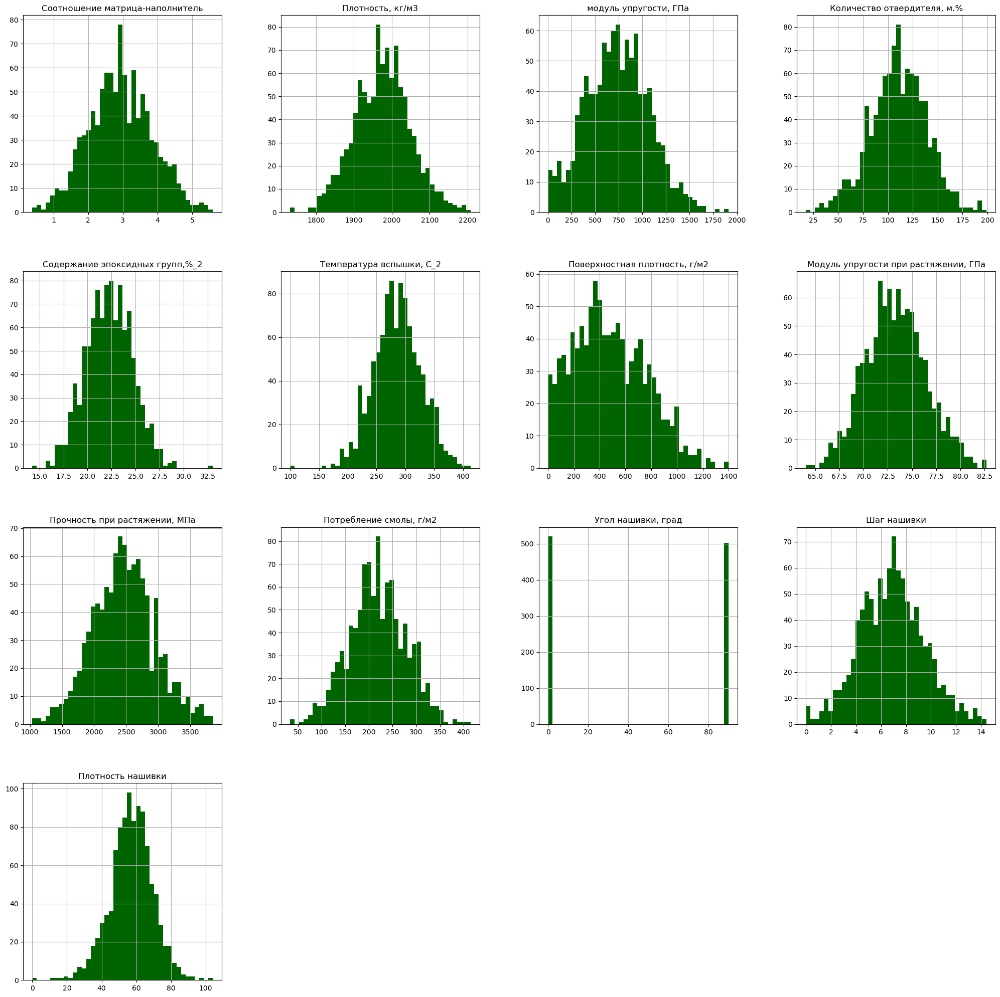

In [24]:
# Гистограмма отображает распределение значений в столбце без нормализации и стандартизации.
# `bins` задаёт количество интервалов для каждой гистограммы.
# `figsize` задаёт размер фигуры для всех гистограмм, чтобы они были крупнее и лучше видны.

df.hist(figsize = (25,25), bins=40, color = "darkgreen")
plt.show()

## Вычислим коэффициенты ранговой корреляции Кендалла, чтобы оценить статистическую зависимость.


In [25]:
# Интерпретация коэффициента ранговой корреляции Кендалла выглядит следующим образом:
# Прочтение данных:
# если соответствие между обоими рейтингами идеальное, коэффициент имеет значение 1;
# если соответствие между двумя рейтингами отсутствует, коэффициент имеет значение -1
# если коэффициент равен 0 (т.е. половина пар согласованы, а половина нет), зависимость между признаками отсутствует.

df.corr(method = 'kendall')

# Вывод: Корреляционная зависимость не наблюдается ни по одному из параметров

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,-0.003135,0.021247,0.001410,0.010180,-0.009480,-0.002060,-0.004157,0.011614,0.035145,-0.021395,0.022723,0.002788
"Плотность, кг/м3",-0.003135,1.000000,-0.008059,-0.021963,-0.007758,-0.019947,0.037302,-0.021151,-0.047426,-0.017079,-0.051525,-0.031220,0.052935
"модуль упругости, ГПа",0.021247,-0.008059,1.000000,0.022382,0.002351,0.021028,-0.000442,0.005458,0.022959,0.005169,-0.031695,-0.008305,0.049347
"Количество отвердителя, м.%",0.001410,-0.021963,0.022382,1.000000,0.000010,0.059034,0.033110,-0.043140,-0.046507,-0.003677,0.024690,0.006232,0.016607
"Содержание эпоксидных групп,%_2",0.010180,-0.007758,0.002351,0.000010,1.000000,-0.002170,-0.006859,0.041994,-0.013441,0.009756,0.004668,-0.004539,-0.021968
"Температура вспышки, С_2",-0.009480,-0.019947,0.021028,0.059034,-0.002170,1.000000,0.017196,0.016481,-0.019106,0.035313,0.017880,0.029552,0.005268
"Поверхностная плотность, г/м2",-0.002060,0.037302,-0.000442,0.033110,-0.006859,0.017196,1.000000,0.024051,-0.005099,-0.004446,0.045452,0.025514,-0.022320
"Модуль упругости при растяжении, ГПа",-0.004157,-0.021151,0.005458,-0.043140,0.041994,0.016481,0.024051,1.000000,-0.006599,0.034814,0.022431,-0.010024,-0.002600
"Прочность при растяжении, МПа",0.011614,-0.047426,0.022959,-0.046507,-0.013441,-0.019106,-0.005099,-0.006599,1.000000,0.013580,0.020609,-0.048049,0.009821
"Потребление смолы, г/м2",0.035145,-0.017079,0.005169,-0.003677,0.009756,0.035313,-0.004446,0.034814,0.013580,1.000000,-0.002402,0.005962,0.010792


## Определим выбросы при помощи диаграммы "Ящик с усами"

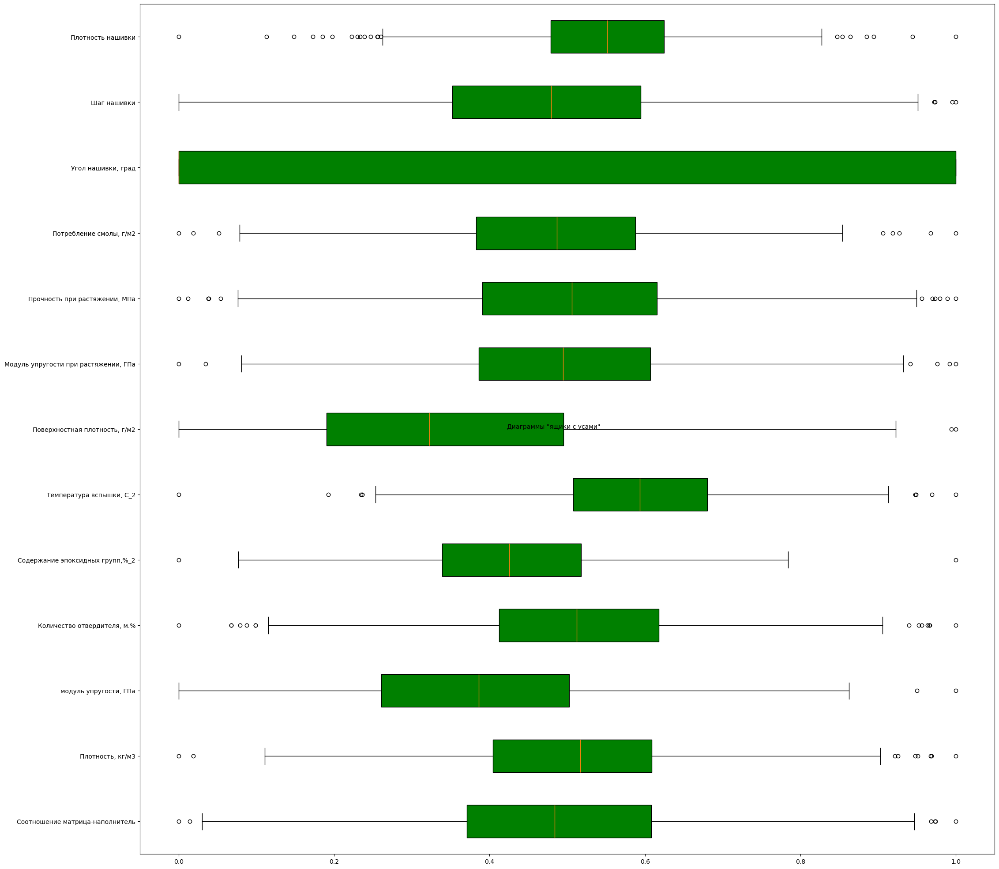

In [26]:
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (25, 25))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.5 ,
             fontsize = 10)
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns, patch_artist = True, meanline = True, vert = False,
            boxprops = dict(facecolor = 'green'))
plt.show()

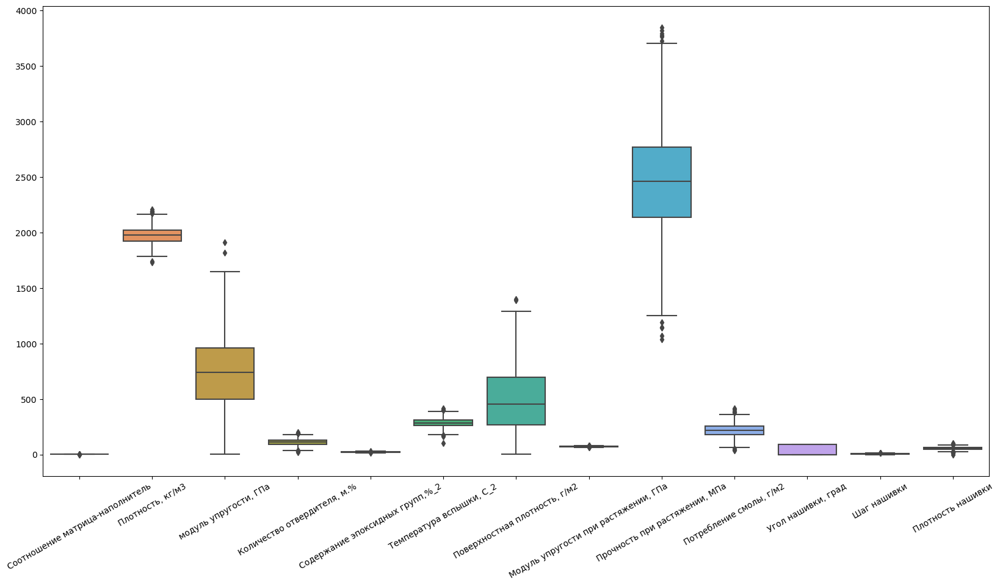

In [27]:
# Создание нового графика с определённым размером
# Boxplot показывает распределение данных по квартилям и позволяет выявить выбросы.plt.figure(figsize = (30,20))
plt.figure(figsize = (20,10))
ax = sns.boxplot(data = df)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

<Axes: ylabel='Density'>

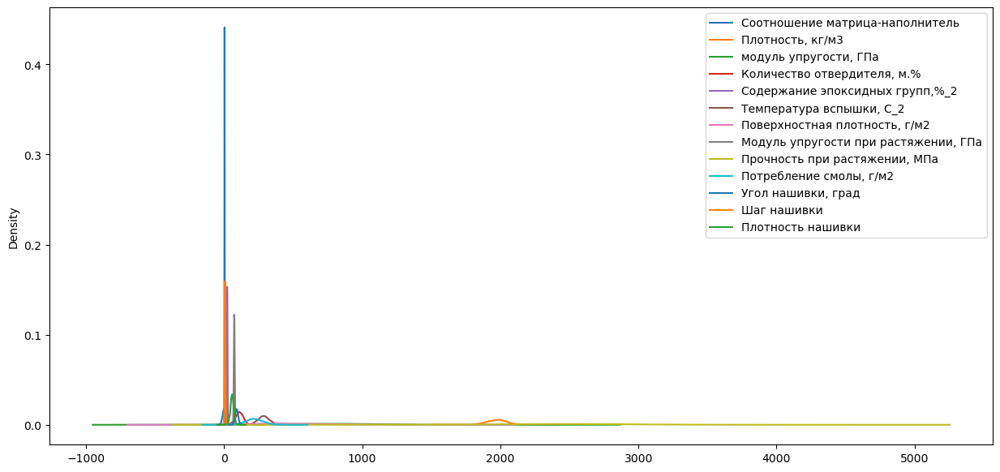

In [28]:
fig, ax = plt.subplots(figsize = (15, 7))
df.plot(kind = 'kde', ax = ax)

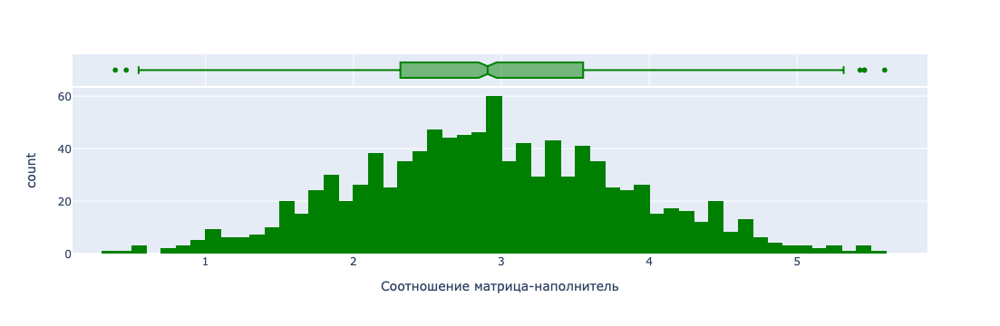

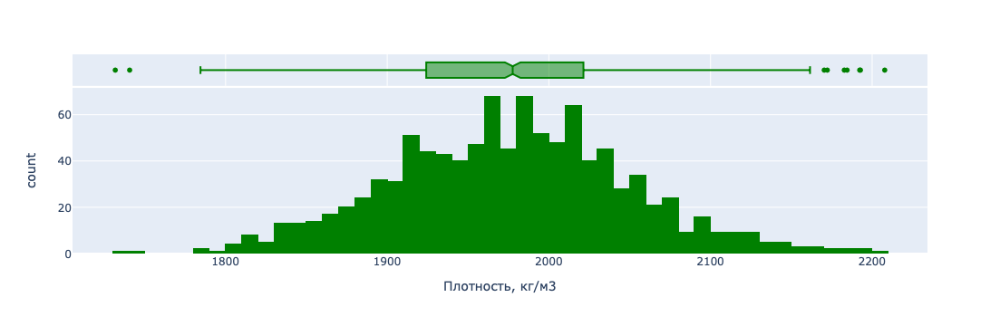

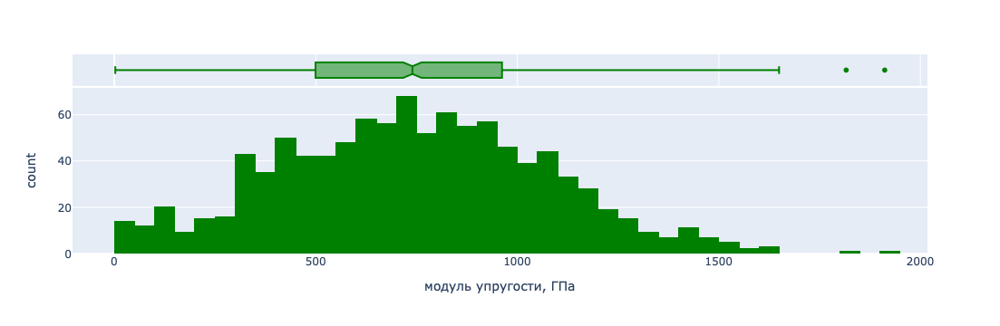

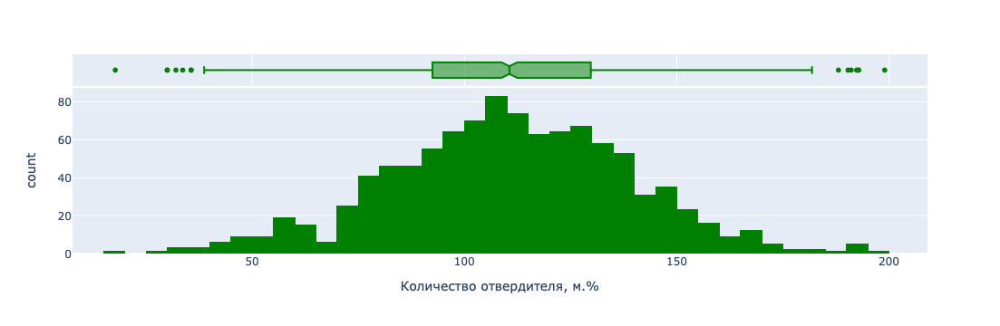

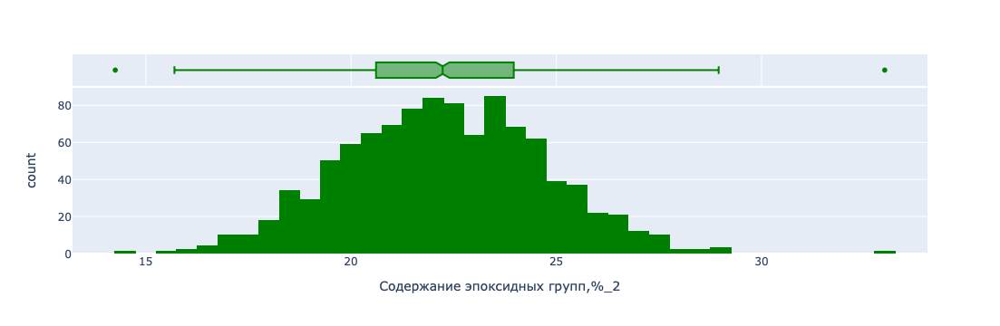

...

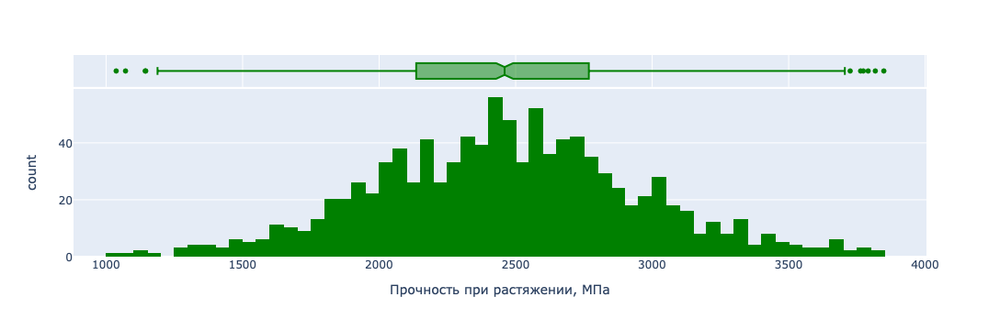

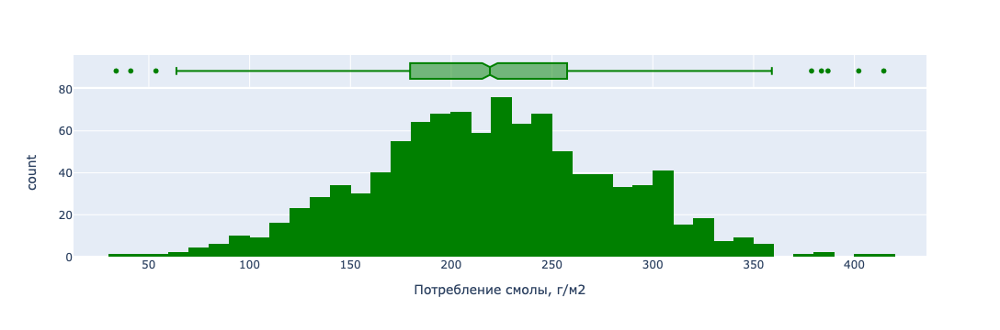

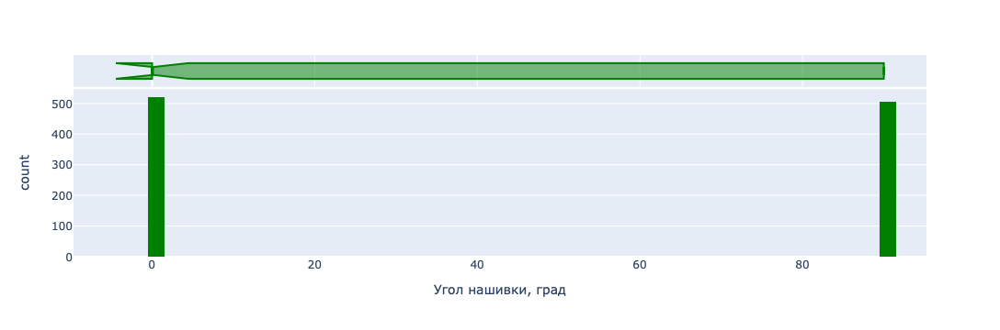

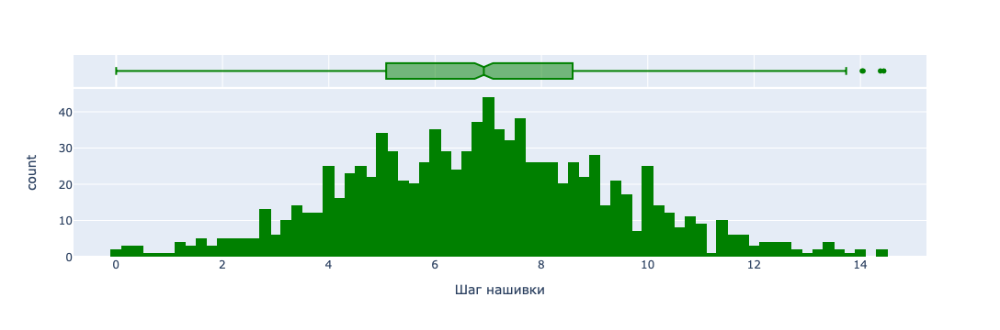

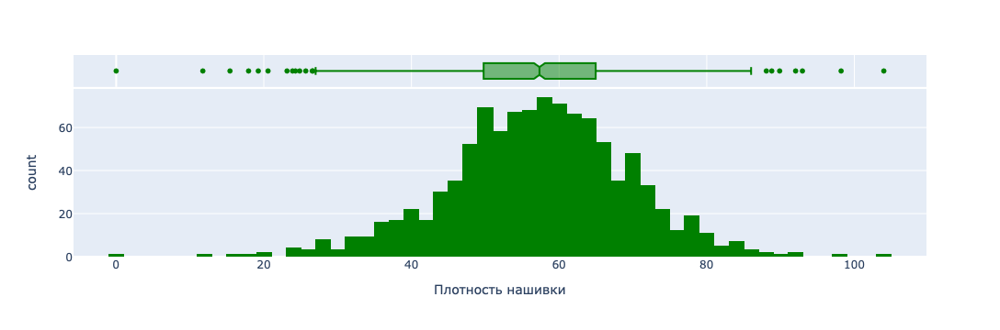

In [29]:
for column in df.columns:
    fig = px.histogram(df, x = column, color_discrete_sequence = ['green'], nbins = 75, marginal = "box")
    fig.show()

## Попарные графики рассеяния точек

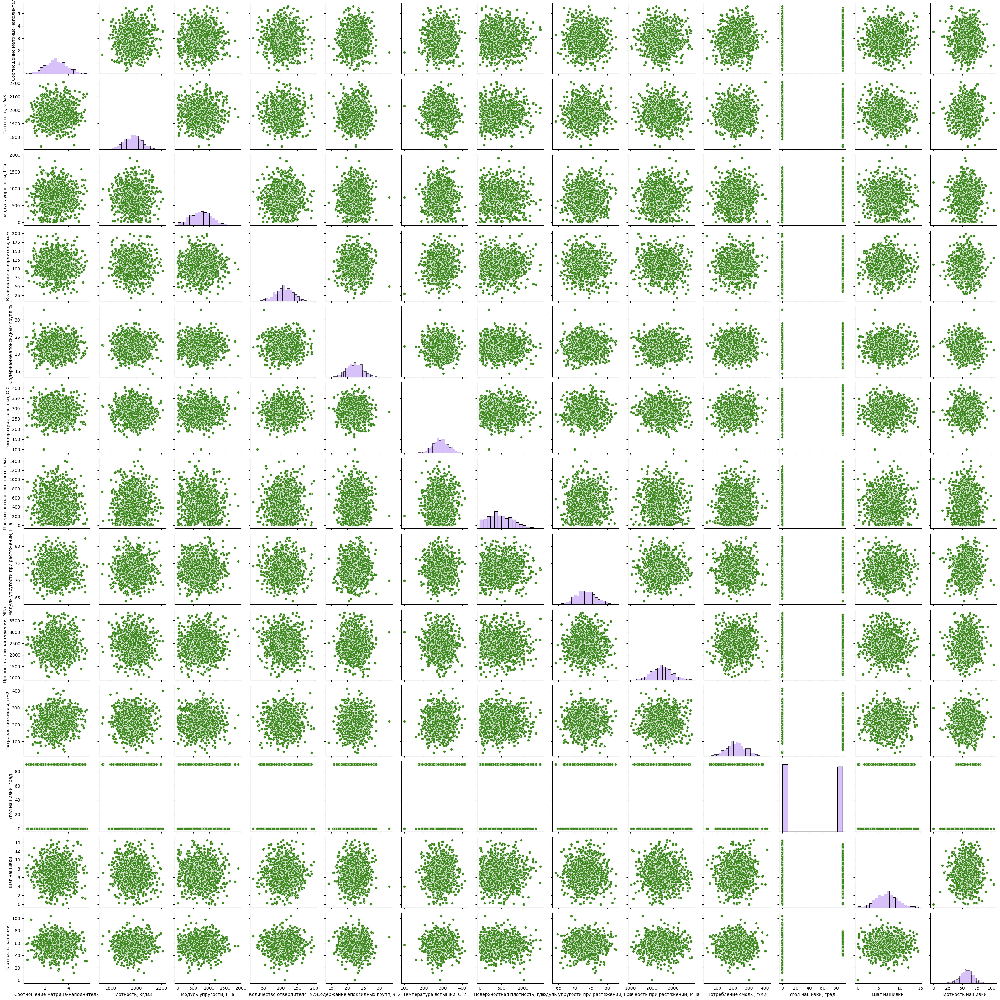

In [30]:
sns.pairplot(df, plot_kws={'color': '#3D881E'}, diag_kws={'color': '#CCADF6'})  # Цвет облаков точек, Цвет диагонали
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

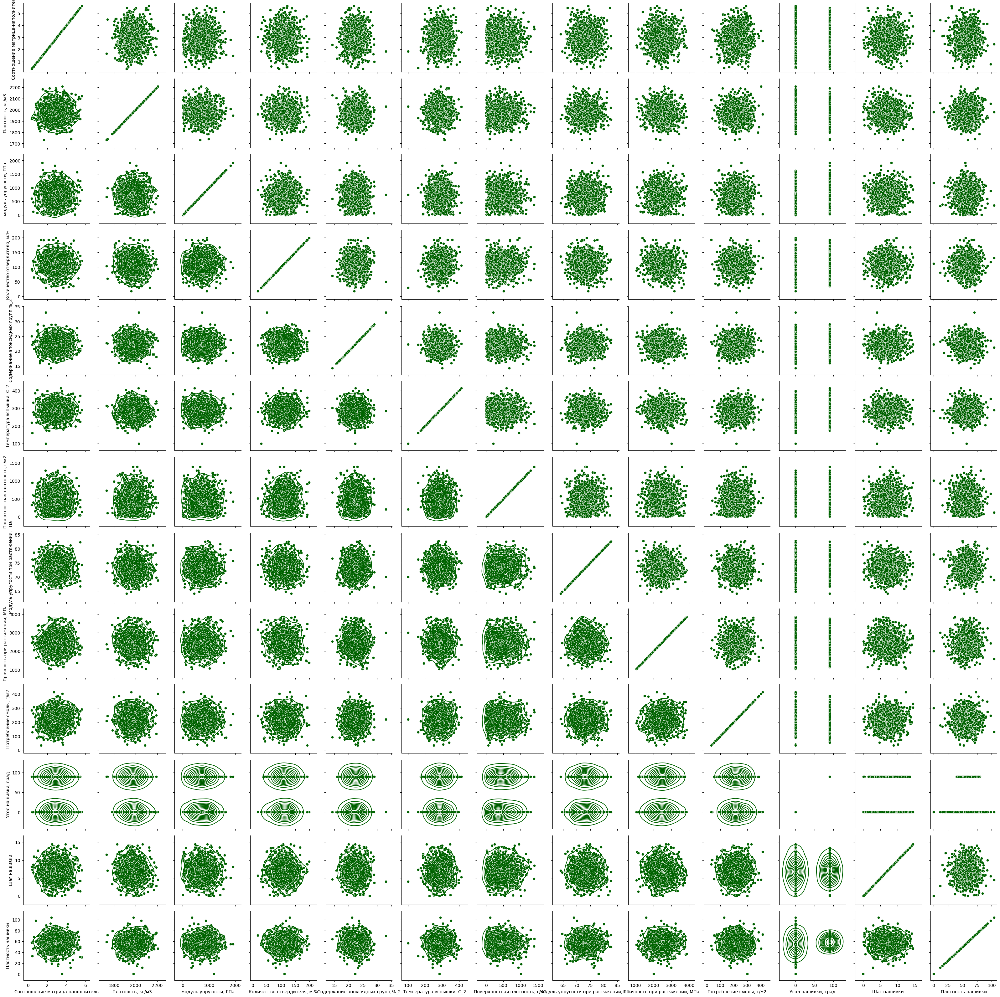

In [31]:
g = sns.PairGrid(df[df.columns])
g.map(sns.scatterplot, color = 'darkgreen')
g.map_upper(sns.scatterplot, color = 'darkgreen')
g.map_lower(sns.kdeplot, color = 'darkgreen')
plt.show
# Корреляции нет

## График квантиль-квантиль Q - Q

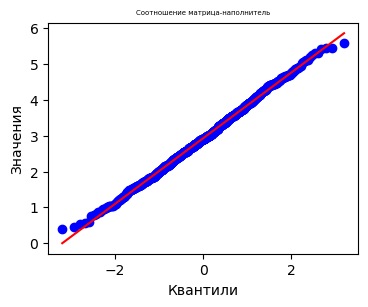

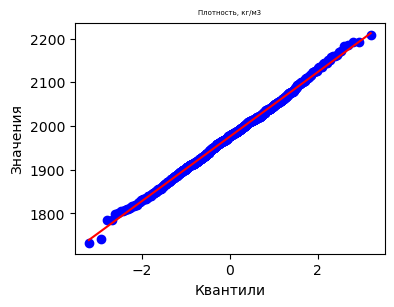

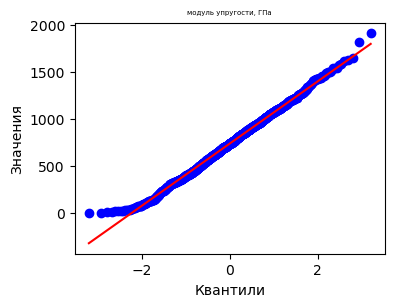

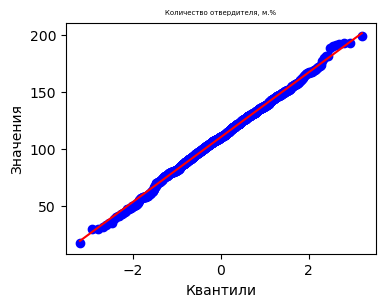

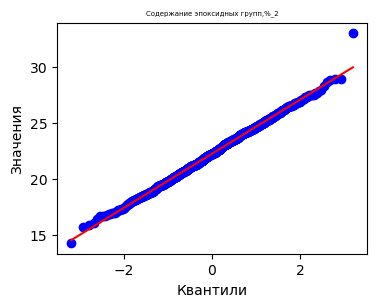

...

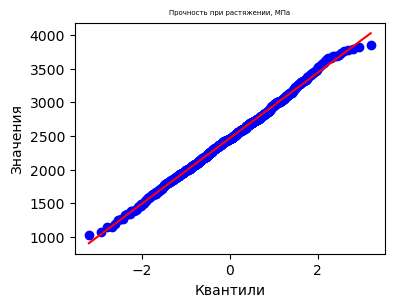

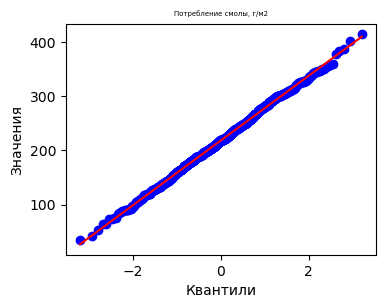

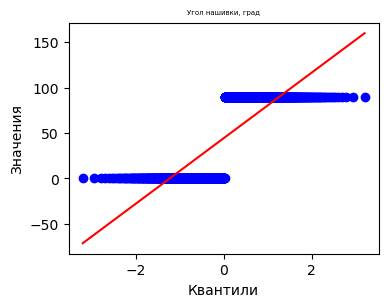

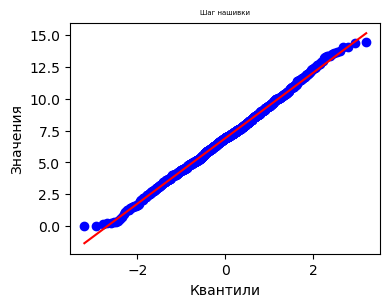

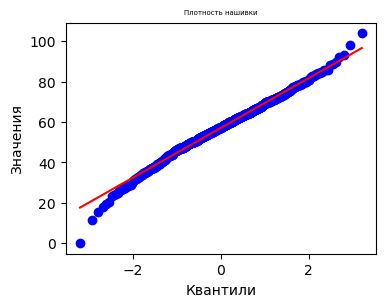

In [32]:
# Оценим степень отклонения данных от теоретического распределения.
# Графики используют выборочные данные, сортируют их в порядке возрастания, после отображают их в сравнении с квантилями, рассчитанными на основе теоретического распределения.

for i in df.columns:
    plt.figure(figsize = (4, 3))
    res = stats.probplot(df[i], plot = plt)
    plt.title(i, fontsize = 5)
    plt.xlabel("Квантили", fontsize = 10)
    plt.ylabel("Значения", fontsize = 10)
    plt.show()

    # Можно сделать вывод, что данные распределены в основном нормально.

## Тепловая карта

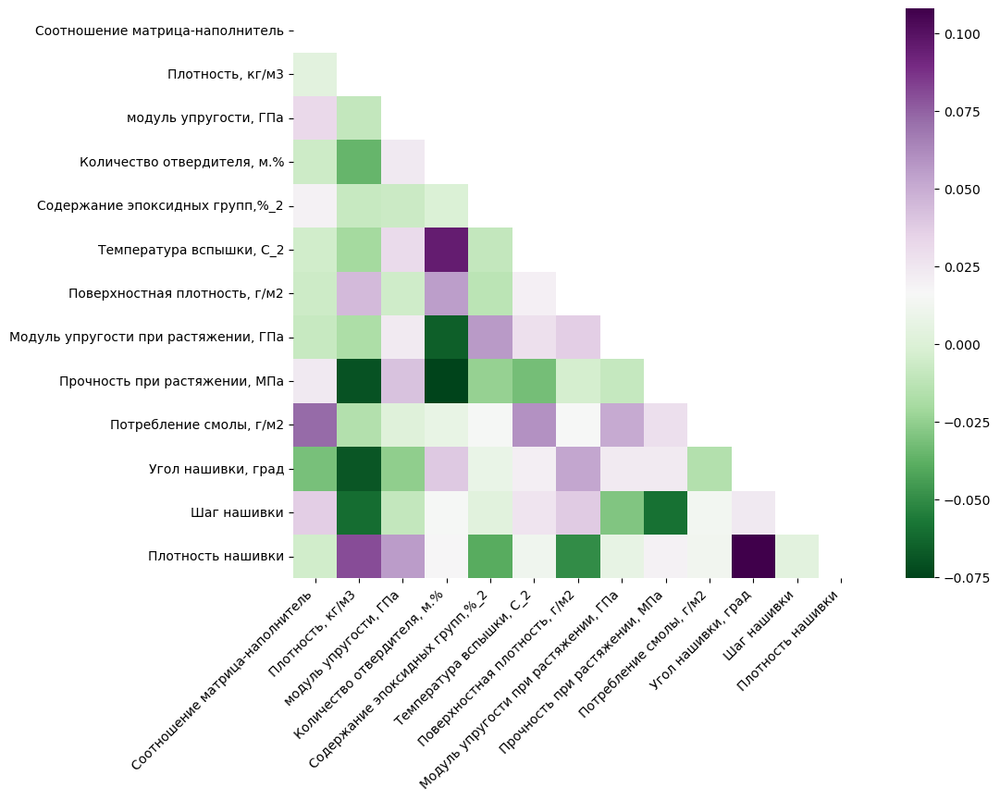

In [33]:
#Визуализация корреляционной матрицы с помощью тепловой карты
matrix = np.triu(df.corr())
f, ax = plt.subplots(figsize = (12, 8)) # Создаем полотно для отображения большого графика
sns.heatmap(df.corr(), mask = matrix, fmt='.3g', annot = True, square = True, cmap = 'PRGn_r') # Визуализируем данные кореляции и создаем цветовую палитру
plt.xticks(rotation = 45, ha='right')
plt.show()

Максимальная корреляция между "Плотностью нашивки и углом нашивки и составляет 0.11, что говорит об отсутствии зависимости между этими данными."
Корреляция между всеми параметрами очень близка к 0, что говорит об отсутствии корреляционных связей между переменными.

# Обработка данных: исключение выбросов и нормализация, стандартизация

## Исключение выбросов

In [34]:
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    return df[~((df < (Q1 - 1.5 * IQR)) |(df > (Q3 + 1.5 * IQR))).any(axis=1)]


df = remove_outliers(df)

print(f"Размерность данных после удаления выбросов методом межквартильного расстояния: {df.shape}")

Размерность данных после удаления выбросов методом межквартильного расстояния: (936, 13)


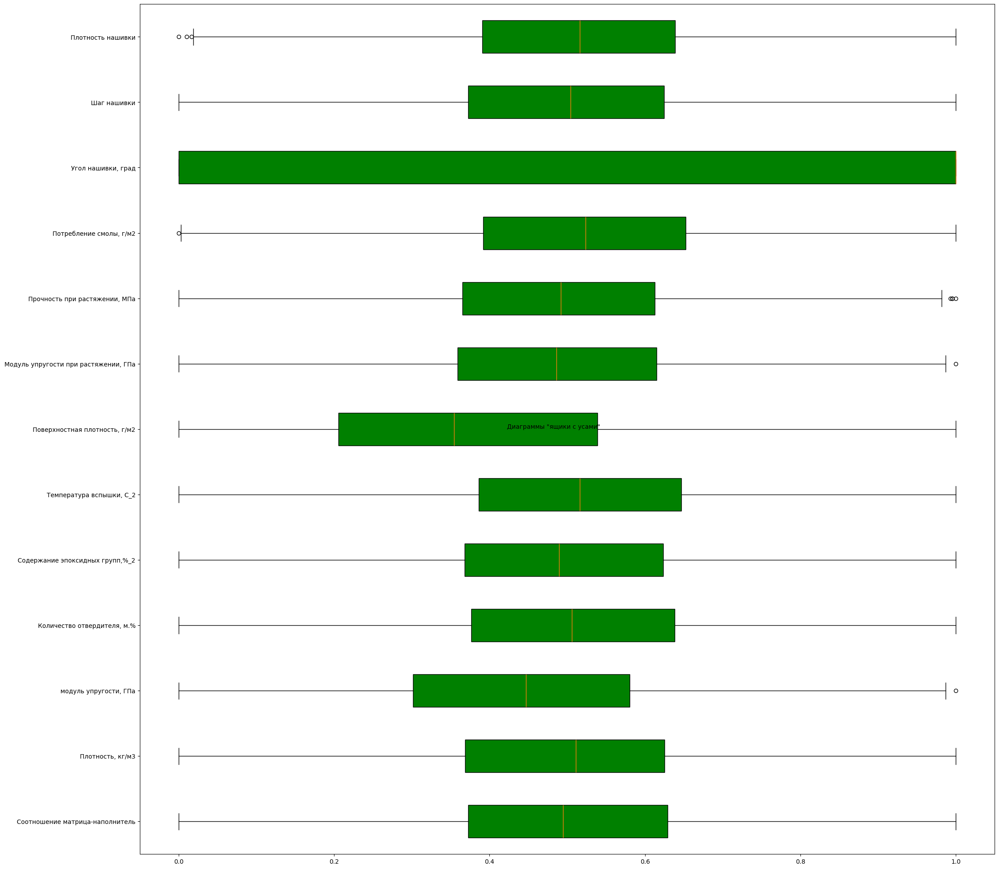

In [35]:
# Визуализируем  диаграмму "Ящик с усами", убедиться, что все выбросы отсечены

scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (25, 25))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.5 ,
             fontsize = 10)
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns, patch_artist = True, meanline = True, vert = False,
            boxprops = dict(facecolor = 'green'))
plt.show()

# продолжаем видеть выбросы. Повторим процедуру очистки датасета от выбросов

In [36]:
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    return df[~((df < (Q1 - 1.5 * IQR)) |(df > (Q3 + 1.5 * IQR))).any(axis=1)]


df_clean_1 = remove_outliers(df)

print(f"Размерность данных после удаления выбросов методом межквартильного расстояния: {df_clean_1.shape}")

Размерность данных после удаления выбросов методом межквартильного расстояния: (926, 13)


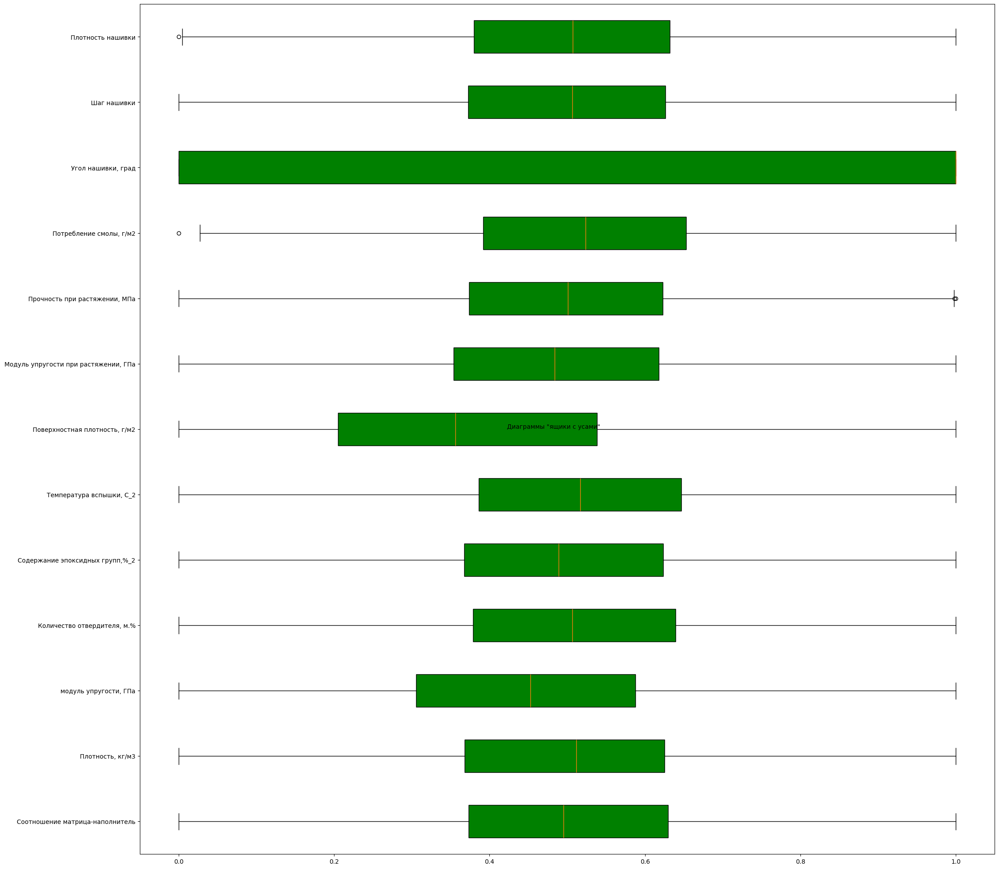

In [37]:
# Визуализируем данные еще раз

scaler = MinMaxScaler()
scaler.fit(df_clean_1)
plt.figure(figsize = (25, 25))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.5 ,
             fontsize = 10)
plt.boxplot(pd.DataFrame(scaler.transform(df_clean_1)), labels = df.columns, patch_artist = True, meanline = True, vert = False,
            boxprops = dict(facecolor = 'green'))
plt.show()

In [38]:
# продолжаем видеть выбросы. Повторим процедуру очистки датасета от выбросов
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    return df[~((df < (Q1 - 1.5 * IQR)) |(df > (Q3 + 1.5 * IQR))).any(axis=1)]


df_clean_2 = remove_outliers(df)

print(f"Размерность данных после удаления выбросов методом межквартильного расстояния: {df_clean_2.shape}")

Размерность данных после удаления выбросов методом межквартильного расстояния: (926, 13)


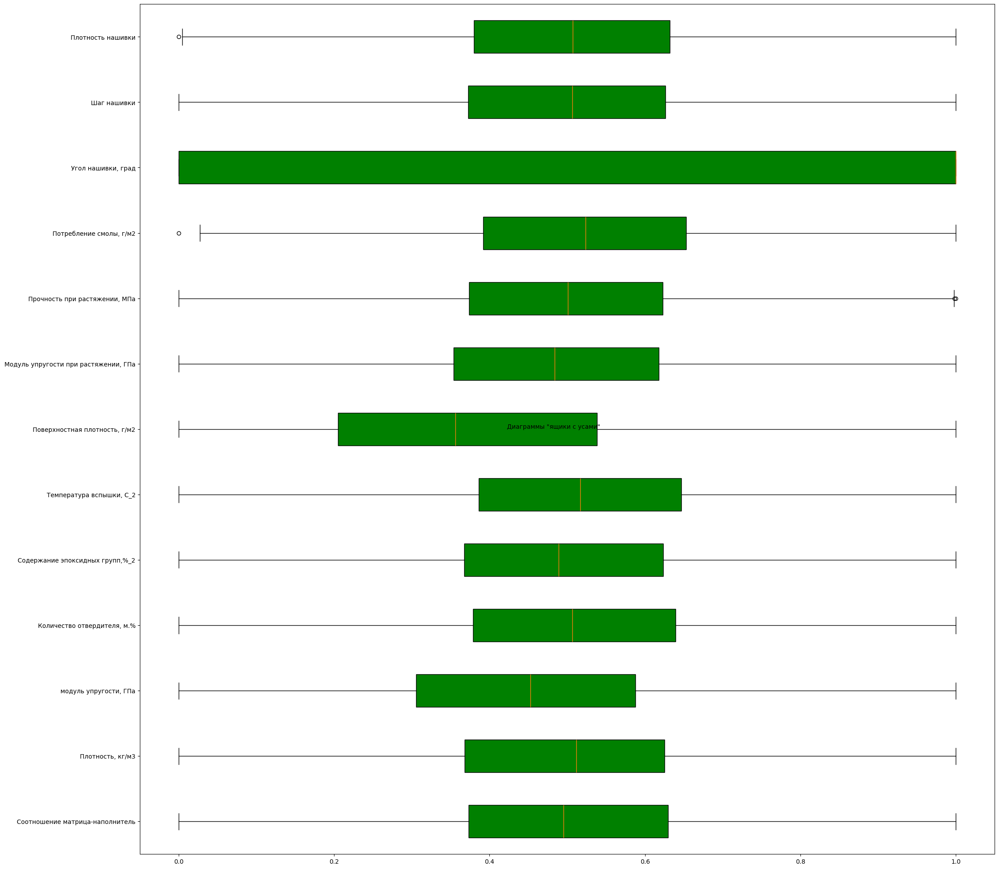

In [39]:
scaler = MinMaxScaler()
scaler.fit(df_clean_2)
plt.figure(figsize = (25, 25))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.5 ,
             fontsize = 10)
plt.boxplot(pd.DataFrame(scaler.transform(df_clean_2)), labels = df.columns, patch_artist = True, meanline = True, vert = False,
            boxprops = dict(facecolor = 'green'))
plt.show()

# Выбросов больше нет. Финальный датасет с параметрами 922, 13.

In [40]:
# Сохраним очищенный датасет :)
df_clean_2.to_excel("Clean_dataset.xlsx")

In [41]:
df_clean_2.shape

(926, 13)

# Нормализация данных

In [42]:
minmaxscaler = MinMaxScaler()
dataset_norm = minmaxscaler.fit_transform(np.array(df[['Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки',
                                     'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'модуль упругости, ГПа',
                                     'Количество отвердителя, м.%', 'Содержание эпоксидных групп,%_2',
                                     'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
                                     'Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа',
                                     'Потребление смолы, г/м2']]))

In [43]:
dataset_norm[:1]

array([[0.        , 0.28933398, 0.55715613, 0.27476816, 0.65109743,
        0.44706097, 0.07915272, 0.60743528, 0.50916426, 0.16223008,
        0.28030276, 0.71258976, 0.52922146]])

In [44]:
dataset_norm_df = pd.DataFrame(dataset_norm, columns = ['Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки',
                                     'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'модуль упругости, ГПа',
                                     'Количество отвердителя, м.%', 'Содержание эпоксидных групп,%_2',
                                     'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
                                     'Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа',
                                     'Потребление смолы, г/м2'])
dataset_norm_df.head()

,"Угол нашивки, град",Шаг нашивки,Плотность нашивки,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,0.0,0.289334,0.557156,0.274768,0.651097,0.447061,0.079153,0.607435,0.509164,0.16223,0.280303,0.71259,0.529221
1,0.0,0.362355,0.335840,0.274768,0.651097,0.447061,0.630983,0.418887,0.583596,0.16223,0.280303,0.71259,0.529221
2,0.0,0.362355,0.506083,0.466552,0.651097,0.455721,0.511257,0.495653,0.509164,0.16223,0.280303,0.71259,0.529221
3,0.0,0.362355,0.557156,0.465836,0.571539,0.452685,0.511257,0.495653,0.509164,0.16223,0.280303,0.71259,0.529221
4,0.0,0.362355,0.727399,0.424236,0.332865,0.488508,0.511257,0.495653,0.509164,0.16223,0.280303,0.71259,0.529221


In [45]:
dataset_norm_df.describe()

,"Угол нашивки, град",Шаг нашивки,Плотность нашивки,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
count,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000,936.000000
mean,0.511752,0.502232,0.513776,0.498933,0.502695,0.446764,0.504664,0.491216,0.516059,0.373733,0.488647,0.495706,0.521141
std,0.500129,0.183258,0.191342,0.187489,0.187779,0.199583,0.188865,0.180620,0.190624,0.217078,0.191466,0.188915,0.195781
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.372211,0.390482,0.372274,0.368517,0.301243,0.376190,0.367716,0.386128,0.205619,0.359024,0.365149,0.392067
50%,1.000000,0.504258,0.516029,0.494538,0.511229,0.447061,0.506040,0.489382,0.515980,0.354161,0.485754,0.491825,0.523766
75%,1.000000,0.624604,0.638842,0.629204,0.624999,0.580446,0.637978,0.623410,0.646450,0.538683,0.615077,0.612874,0.652447
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


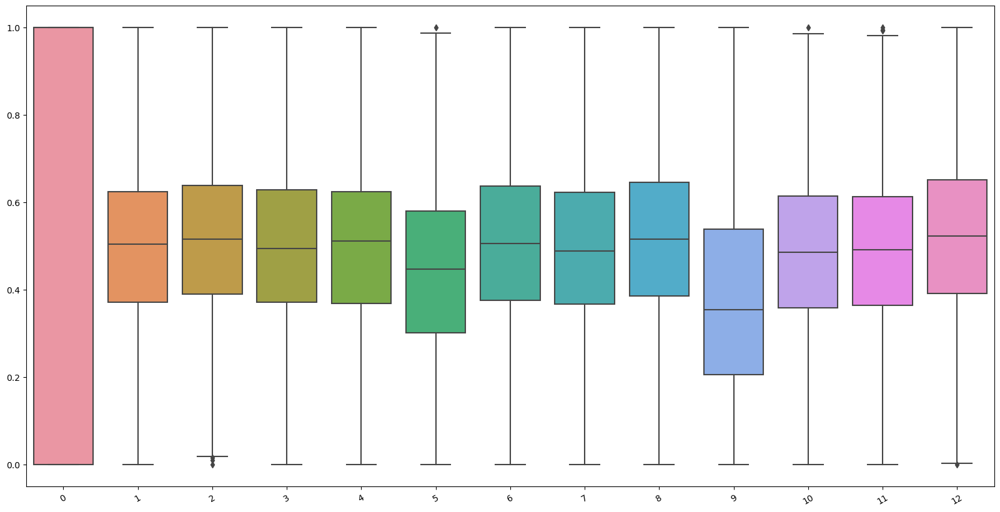

In [46]:
plt.figure(figsize = (20,10))
ax = sns.boxplot(data = dataset_norm)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

<Axes: ylabel='Density'>

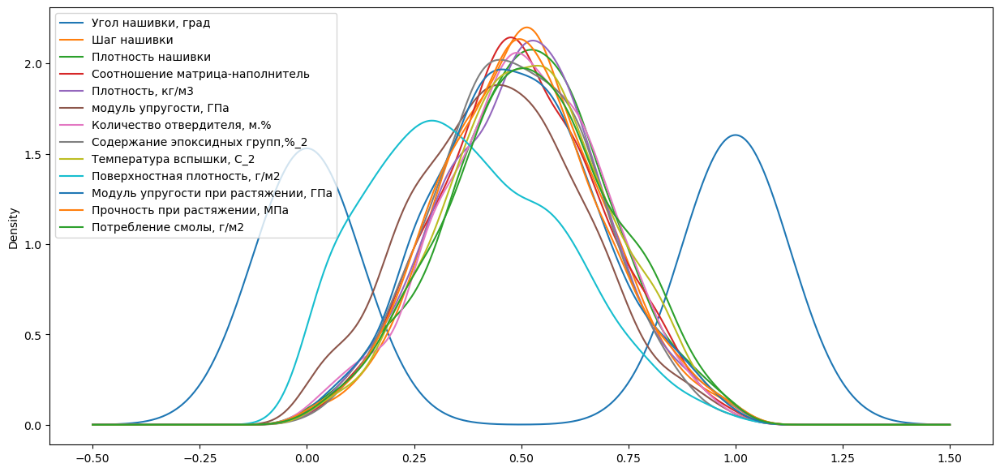

In [47]:
fig, ax = plt.subplots(figsize = (15, 7))
dataset_norm_df.plot(kind = 'kde', ax = ax)

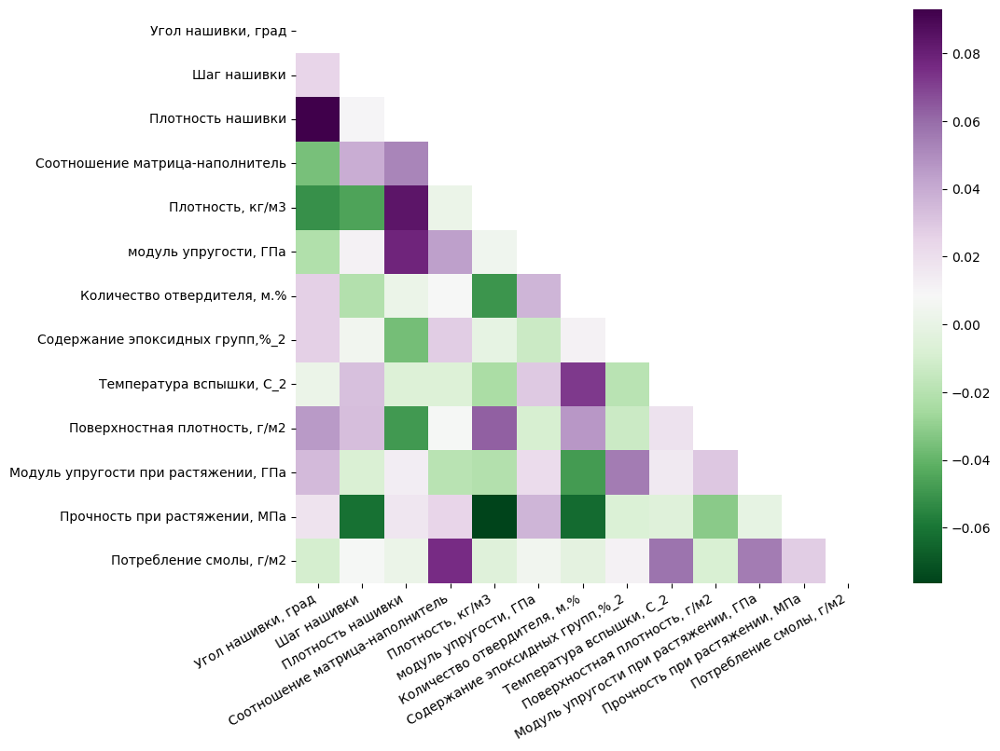

In [48]:
#Визуализация нормализованной матрицы с помощью тепловой карты

matrix1 = np.triu(dataset_norm_df.corr())
f, ax = plt.subplots(figsize = (12, 8))
sns.heatmap(dataset_norm_df.corr(), mask = matrix1, annot = True, fmt='.1g', square = True, cmap = 'PRGn_r')
plt.xticks(rotation = 30, ha='right')
plt.show()


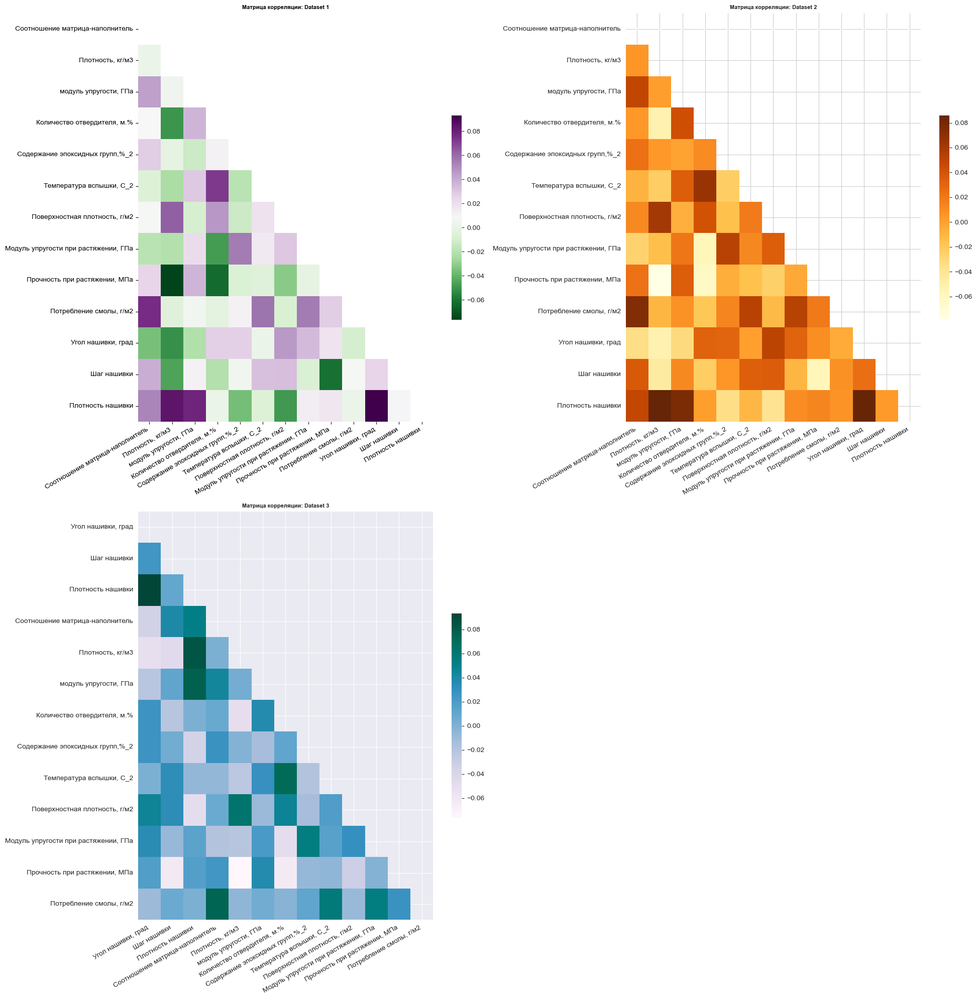

In [49]:
# Установка стилей для каждого графика
styles = ['whitegrid', 'darkgrid', 'ticks']
colormaps = ['PRGn_r', 'YlOrBr', 'PuBuGn']
titles = ['Матрица корреляции: Dataset 1', 'Матрица корреляции: Dataset 2', 'Матрица корреляции: Dataset 3']

# Создание фигуры и сетки с увеличенным размером
fig = plt.figure(figsize=(20, 20))
gs = GridSpec(2, 2, height_ratios=[1, 1])

# Построение первого графика (сверху слева)
matrix1 = np.triu(df.corr())
ax1 = fig.add_subplot(gs[0, 0])
sns.set_style(styles[0])
sns.heatmap(df.corr(), mask = matrix1, annot=True, cmap=colormaps[0], ax=ax1, fmt='.2g', cbar_kws={'shrink': .5}, annot_kws={"size": 8})
ax1.set_title(titles[0], fontsize=8, fontweight='bold')
plt.xticks(rotation = 30, ha='right')

# Построение второго графика (сверху справа)
matrix2 = np.triu(df_clean_2.corr())
ax2 = fig.add_subplot(gs[0, 1])
sns.set_style(styles[1])
sns.heatmap(df_clean_2.corr(), mask = matrix2, annot=True, cmap=colormaps[1], ax=ax2, fmt='.2g', cbar_kws={'shrink': .5}, annot_kws={"size": 8})
ax2.set_title(titles[1], fontsize=8, fontweight='bold')
plt.xticks(rotation = 30, ha='right')

# Построение третьего графика (снизу слева)
matrix3 = np.triu(dataset_norm_df.corr())
ax3 = fig.add_subplot(gs[1, 0])
sns.set_style(styles[2])
sns.heatmap(dataset_norm_df.corr(),mask = matrix3, annot=True, cmap=colormaps[2], ax=ax3, fmt='.2g', cbar_kws={'shrink': .5}, annot_kws={"size": 8})
ax3.set_title(titles[2], fontsize=8, fontweight='bold')
plt.xticks(rotation = 30, ha='right')

# Настройка шрифта для всей фигуры
plt.rcParams['font.family'] = 'DejaVu Sans'
plt.tight_layout()
plt.xticks(rotation = 30, ha='right')
plt.show()

# Стандартизируем данные

In [50]:
std_scaler = StandardScaler()
dataset_std = std_scaler.fit_transform(np.array(df[['Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки',
                                     'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'модуль упругости, ГПа',
                                     'Количество отвердителя, м.%', 'Содержание эпоксидных групп,%_2',
                                     'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
                                     'Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа',
                                     'Потребление смолы, г/м2']]))

In [51]:
dataset_std_df = pd.DataFrame(dataset_std, columns = ['Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки',
                                     'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'модуль упругости, ГПа',
                                     'Количество отвердителя, м.%', 'Содержание эпоксидных групп,%_2',
                                     'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
                                     'Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа',
                                     'Потребление смолы, г/м2'])
dataset_std_df.head()

,"Угол нашивки, град",Шаг нашивки,Плотность нашивки,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,-1.023787,-1.162360,0.226834,-1.196260,0.790727,0.001489,-2.254199,0.643790,-0.036187,-0.974837,-1.088732,1.148666,0.041294
1,-1.023787,-0.763689,-0.930436,-1.196260,0.790727,0.001489,0.669189,-0.400666,0.354488,-0.974837,-1.088732,1.148666,0.041294
2,-1.023787,-0.763689,-0.040228,-0.172802,0.790727,0.044904,0.034925,0.024577,-0.036187,-0.974837,-1.088732,1.148666,0.041294
3,-1.023787,-0.763689,0.226834,-0.176623,0.366820,0.029685,0.034925,0.024577,-0.036187,-0.974837,-1.088732,1.148666,0.041294
4,-1.023787,-0.763689,1.117043,-0.398622,-0.904900,0.209271,0.034925,0.024577,-0.036187,-0.974837,-1.088732,1.148666,0.041294


In [52]:
dataset_std_df.describe()

,"Угол нашивки, град",Шаг нашивки,Плотность нашивки,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
count,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02,9.360000e+02
mean,1.214603e-16,-2.068621e-16,-1.821904e-16,-3.985416e-16,-1.040004e-15,1.480297e-16,-4.934325e-17,-8.264994e-16,2.827748e-16,1.537232e-16,-4.531987e-15,7.591269e-16,-1.622634e-16
std,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00,1.000535e+00
min,-1.023787e+00,-2.742040e+00,-2.686557e+00,-2.662564e+00,-2.678494e+00,-2.239686e+00,-2.673520e+00,-2.721073e+00,-2.708660e+00,-1.722572e+00,-2.553495e+00,-2.625366e+00,-2.663276e+00
25%,-1.023787e+00,-7.098730e-01,-6.447102e-01,-6.759174e-01,-7.149367e-01,-7.295171e-01,-6.806090e-01,-6.841247e-01,-6.819752e-01,-7.748511e-01,-6.773608e-01,-6.914559e-01,-6.596313e-01
50%,9.767656e-01,1.106404e-02,1.178012e-02,-2.345711e-02,4.547134e-02,1.489090e-03,7.288461e-03,-1.015960e-02,-4.138363e-04,-9.020710e-02,-1.511879e-02,-2.055487e-02,1.341504e-02
75%,9.767656e-01,6.681197e-01,6.539752e-01,6.951888e-01,6.516681e-01,6.701651e-01,7.062473e-01,7.322835e-01,6.843897e-01,7.602716e-01,6.606792e-01,6.205483e-01,6.710354e-01
max,9.767656e-01,2.717671e+00,2.542482e+00,2.673947e+00,2.649773e+00,2.773444e+00,2.624101e+00,2.818386e+00,2.540085e+00,2.886532e+00,2.672150e+00,2.670853e+00,2.447193e+00


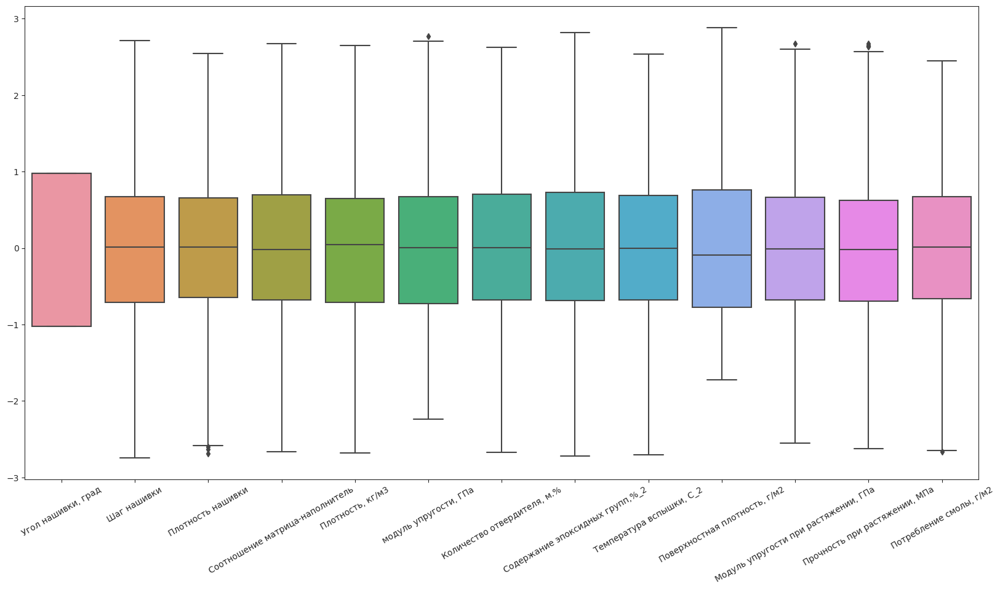

In [53]:
plt.figure(figsize = (20,10))
ax = sns.boxplot(data = dataset_std_df)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

<Axes: ylabel='Density'>

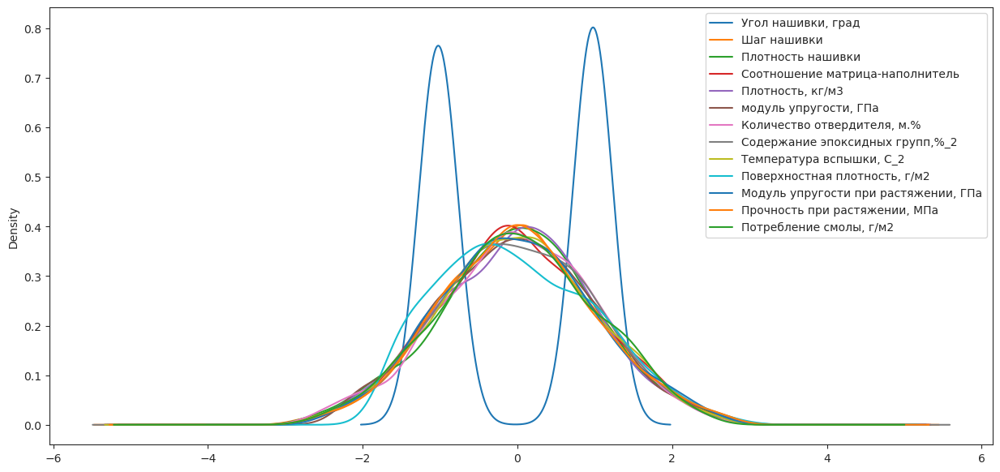

In [54]:
fig, ax = plt.subplots(figsize = (15, 7))
dataset_std_df.plot(kind = 'kde', ax = ax)

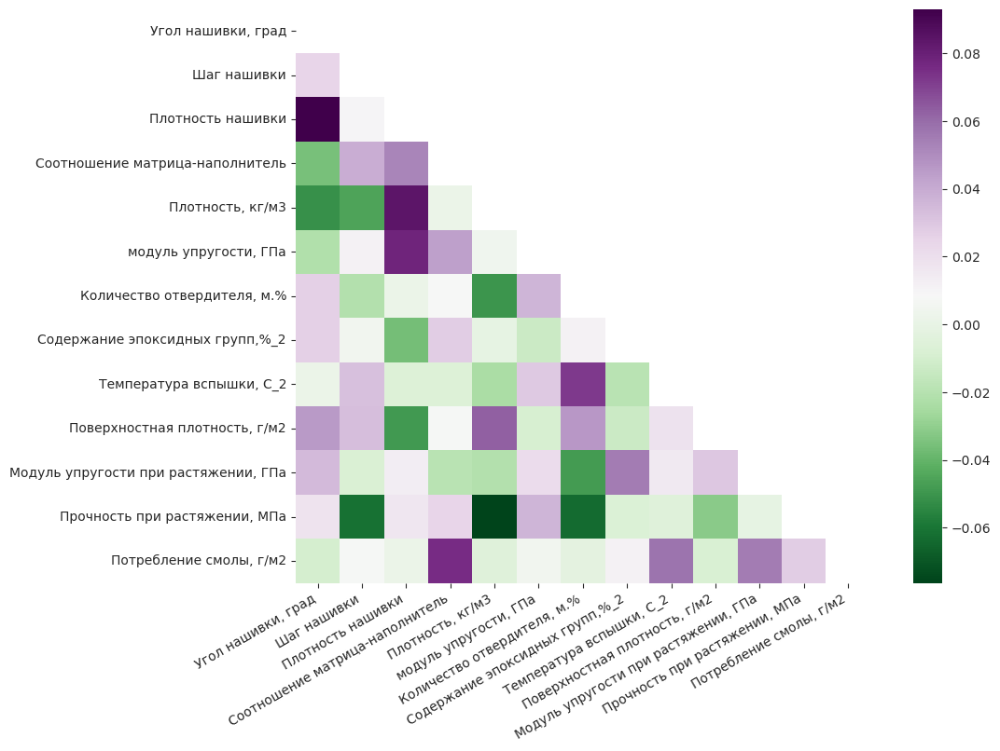

In [55]:
#Визуализация стандартизированной матрицы с помощью тепловой карты
matrix = np.triu(dataset_std_df.corr())
f, ax = plt.subplots(figsize = (12, 8))
sns.heatmap(dataset_std_df.corr(), mask = matrix, annot = True, fmt='.1g', square = True, cmap = 'PRGn_r')
plt.xticks(rotation = 30, ha='right')
plt.show()

# Разработка и обучение нескольких моделей

## Формирование выборок: тестовая 30%, тренировочная 70%.

Целевые переменные:

- Прочность при растяжении, МПа.
- Модуль упругости при растяжении, ГПа;

## Сначала построим модели для 1 фичи - "Прочность при растяжении"

## Метод линейной регрессии - Linear Regression

In [56]:
# Определяем признаки (X) и целевые переменные (y)
X = dataset_norm_df.drop(columns=['Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа'])
y_tensile_elastic_modulus = dataset_norm_df['Модуль упругости при растяжении, ГПа']
y_tensile_strength = dataset_norm_df['Прочность при растяжении, МПа']

In [57]:
# Разделяем данные на обучающую и тестовую выборки
X_train, X_test, y_train_elastic_modulus, y_test_elastic_modulus = train_test_split(
    X, y_tensile_elastic_modulus, test_size=0.3, random_state=42)

X_train, X_test, y_train_strength, y_test_strength = train_test_split(
    X, y_tensile_strength, test_size=0.3, random_state=42)

In [58]:
# Создаем и обучаем модель линейной регрессии для каждого целевого признака
model_elastic_modulus = LinearRegression()
model_elastic_modulus.fit(X_train, y_train_elastic_modulus)

model_strength = LinearRegression()
model_strength.fit(X_train, y_train_strength)

LinearRegression()

In [59]:
# Делаем предсказания на тестовой выборке (Вычисление коэффициента детерминации)
y_pred_elastic_modulus = model_elastic_modulus.predict(X_test)
y_pred_strength = model_strength.predict(X_test)

In [60]:
# Оцениваем качество модели
mae_lr = mean_absolute_error(y_test_elastic_modulus, y_pred_elastic_modulus)
mse_lr = mean_squared_error(y_test_elastic_modulus, y_pred_elastic_modulus)
r2_lr = r2_score(y_test_elastic_modulus, y_pred_elastic_modulus)

mae_lr_2 = mean_absolute_error(y_test_strength, y_pred_strength)
mse_lr_2 = mean_squared_error(y_test_strength, y_pred_strength)
r2_lr_2 = r2_score(y_test_strength, y_pred_strength)

print("Модуль упругости при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_lr:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_lr:.2f}")
print(f"Коэффициент детерминации (R^2): {r2_lr:.2f}")

print("\nПрочность при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_lr_2:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_lr_2:.2f}")
print(f"Коэффициент детерминации (R^2): {r2_lr_2:.2f}")


Модуль упругости при растяжении:
Средняя абсолютная ошибка (MAE): 0.15
Среднеквадратичная ошибка (MSE): 0.03
Коэффициент детерминации (R^2): -0.00

Прочность при растяжении:
Средняя абсолютная ошибка (MAE): 0.15
Среднеквадратичная ошибка (MSE): 0.04
Коэффициент детерминации (R^2): -0.05


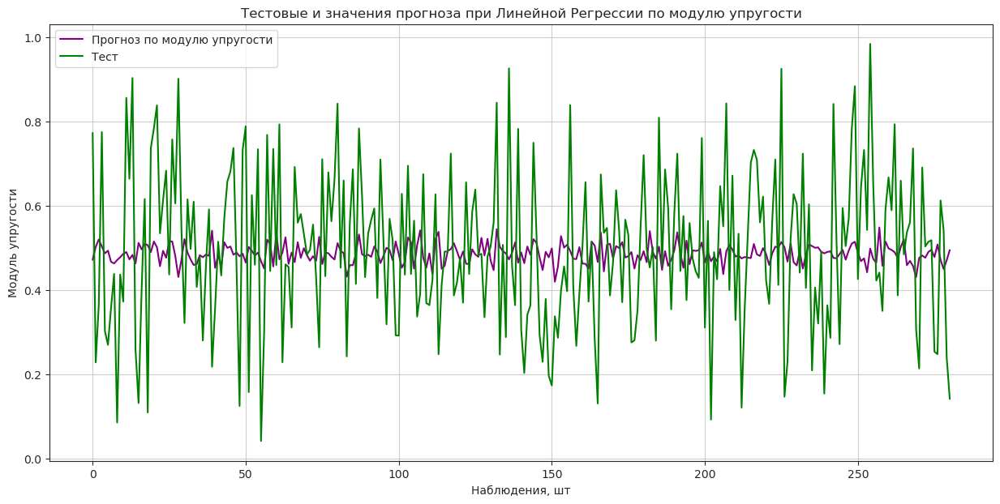

In [61]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Линейной Регрессии по модулю упругости")
plt.plot(y_pred_elastic_modulus, label="Прогноз по модулю упругости", color = 'purple')
plt.plot(y_test_elastic_modulus.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Модуль упругости")
plt.legend()
plt.grid(True);

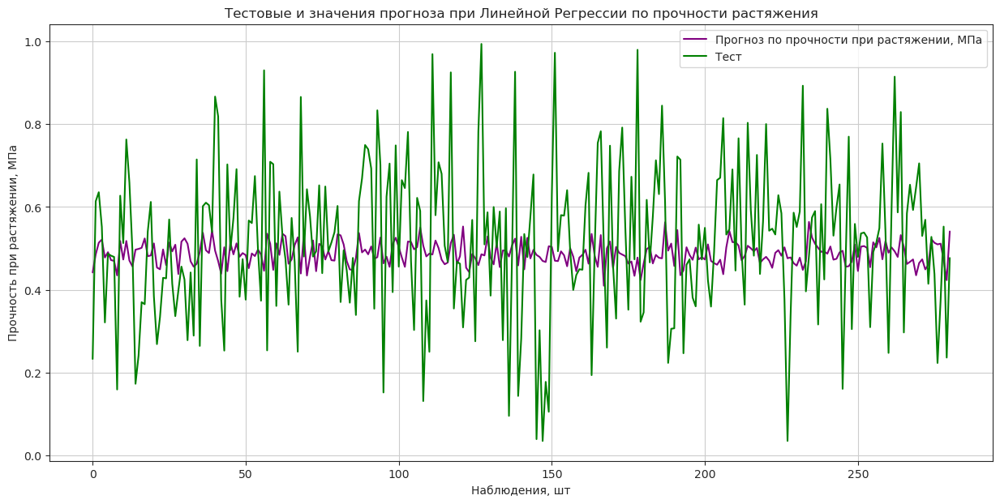

In [62]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Линейной Регрессии по прочности растяжения")
plt.plot(y_pred_strength, label="Прогноз по прочности при растяжении, МПа", color = 'purple')
plt.plot(y_test_strength.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Низкие показатели говорят о том, что метод Линейная регрессия Linear Regression плохо подходит для прогнозирования данного датасета 

## Метод случайного леса - Random Forest Regressor

In [63]:
# Определение признаков и целевых переменных
features = [
    'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'Количество отвердителя, м.%',
    'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
    'Потребление смолы, г/м2', 'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки'
]
target_modulus = 'Модуль упругости при растяжении, ГПа'
target_strength = 'Прочность при растяжении, МПа'

In [64]:
# Разделение данных на обучающую и тестовую выборки
X = dataset_norm_df[features]
y_modulus = dataset_norm_df[target_modulus]
y_strength = dataset_norm_df[target_strength]

X_train, X_test, y_train_modulus, y_test_modulus = train_test_split(X, y_modulus, test_size=0.3, random_state=42)
X_train, X_test, y_strength_train, y_strength_test = train_test_split(X, y_strength, test_size=0.3, random_state=42)

In [65]:
# Обучение модели случайного леса для модуля упругости при растяжении
model_modulus = RandomForestRegressor(random_state=42)
model_modulus.fit(X_train, y_train_modulus)

# Обучение модели случайного леса для прочности при растяжении
model_strength = RandomForestRegressor(random_state=42)
model_strength.fit(X_train, y_strength_train)

RandomForestRegressor(random_state=42)

In [66]:
# Предсказание и оценка качества модели для модуля упругости при растяжении
y_pred_modulus = model_modulus.predict(X_test)

mae_modulus = mean_absolute_error(y_test_modulus, y_pred_modulus)
mse_modulus = mean_squared_error(y_test_modulus, y_pred_modulus)
r2_modulus = r2_score(y_test_modulus, y_pred_modulus)

print("Модуль упругости при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_modulus:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_modulus:.2f}")
print(f"Коэффициент детерминации (R²): {r2_modulus:.2f}")

Модуль упругости при растяжении:
Средняя абсолютная ошибка (MAE): 0.15
Среднеквадратичная ошибка (MSE): 0.04
Коэффициент детерминации (R²): -0.04


In [67]:
# Предсказание и оценка качества модели для прочности при растяжении
y_pred_strength_forest = model_strength.predict(X_test)

mae_strength_2 = mean_absolute_error(y_strength_test, y_pred_strength_forest)
mse_strength_2 = mean_squared_error(y_strength_test, y_pred_strength_forest)
r2_strength_2 = r2_score(y_strength_test, y_pred_strength_forest)

print("\nПрочность при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_strength_2:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_strength_2:.2f}")
print(f"Коэффициент детерминации (R²): {r2_strength_2:.2f}")


Прочность при растяжении:
Средняя абсолютная ошибка (MAE): 0.15
Среднеквадратичная ошибка (MSE): 0.04
Коэффициент детерминации (R²): -0.09


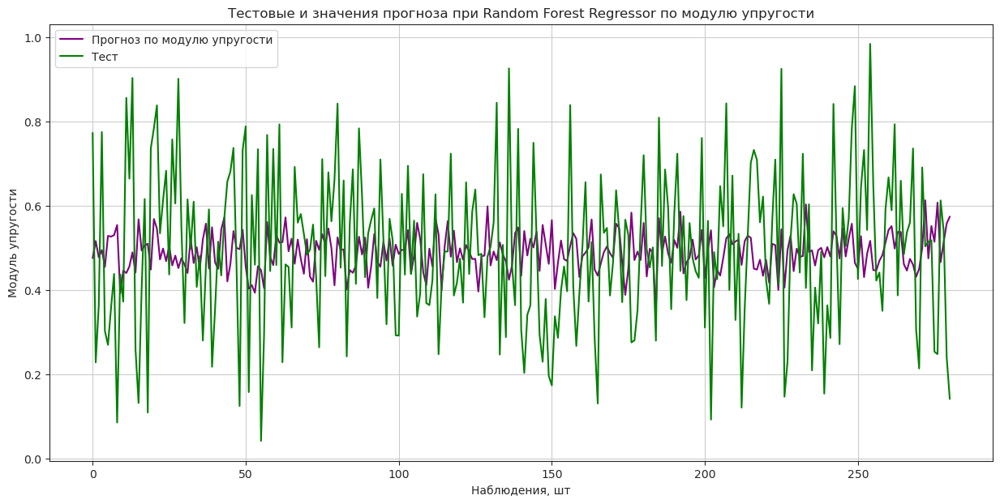

In [68]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Random Forest Regressor по модулю упругости")
plt.plot(y_pred_modulus, label="Прогноз по модулю упругости", color = 'purple')
plt.plot(y_test_modulus.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Модуль упругости")
plt.legend()
plt.grid(True);

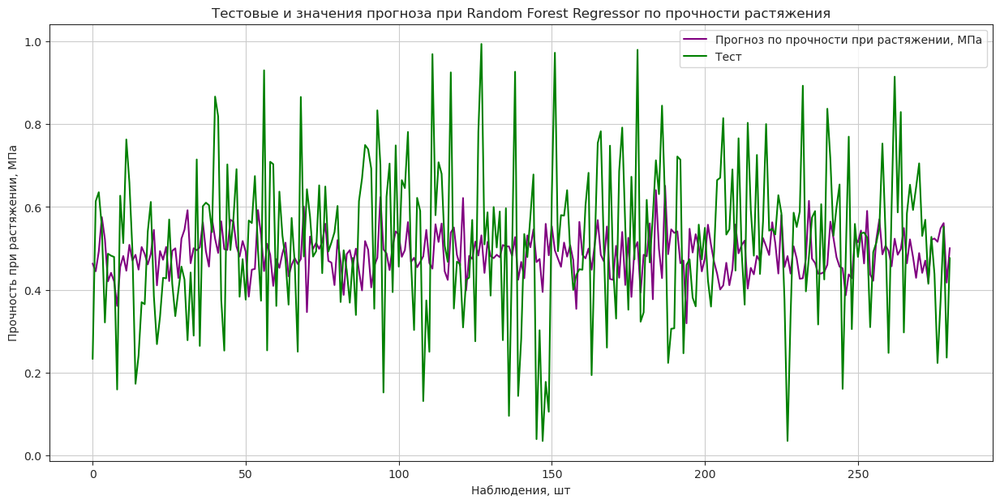

In [69]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Random Forest Regressor по прочности растяжения")
plt.plot(y_pred_strength_forest, label="Прогноз по прочности при растяжении, МПа", color = 'purple')
plt.plot(y_strength_test.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Низкие показатели говорят о том, что метод случайного леса - Random Forest Regressor плохо подходит для прогнозирования данного датасета 

## Метод градиентного бустинга - Gradient Boosting Regressor 

In [70]:
# Определение признаков и целевых переменных
features = [
    'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'Количество отвердителя, м.%',
    'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
    'Потребление смолы, г/м2', 'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки'
]
target_modulus = 'Модуль упругости при растяжении, ГПа'
target_strength = 'Прочность при растяжении, МПа'

In [71]:
# Разделение данных на обучающую и тестовую выборки
X = dataset_norm_df[features]
y_modulus = dataset_norm_df[target_modulus]
y_strength = dataset_norm_df[target_strength]

X_train, X_test, y_modulus_train, y_modulus_test = train_test_split(X, y_modulus, test_size=0.3, random_state=42)
X_train, X_test, y_strength1_train, y_strength1_test = train_test_split(X, y_strength, test_size=0.3, random_state=42)

In [72]:
# Для модуля упругости при растяжении
gb_modulus = GradientBoostingRegressor(random_state=42)
gb_modulus.fit(X_train, y_modulus_train)

# Для прочности при растяжении
gb_strength = GradientBoostingRegressor(random_state=42)
gb_strength.fit(X_train, y_strength1_train)

GradientBoostingRegressor(random_state=42)

In [73]:
# Предсказания для тестовой выборки
y_modulus_pred = gb_modulus.predict(X_test)
y_strength_pred = gb_strength.predict(X_test)

In [74]:
# Оценка качества модели для модуля упругости при растяжении
mae_b = mean_absolute_error(y_modulus_test, y_modulus_pred)
mse_b = mean_squared_error(y_modulus_test, y_modulus_pred)
r2_b = r2_score(y_modulus_test, y_modulus_pred)

print(f"Модуль упругости при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_b:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_b:.2f}")
print(f"Коэффициент детерминации (R²): {r2_b:.2f}")

Модуль упругости при растяжении:
Средняя абсолютная ошибка (MAE): 0.15
Среднеквадратичная ошибка (MSE): 0.04
Коэффициент детерминации (R²): -0.05


In [75]:
# Оценка качества модели для прочности при растяжении
mae_b2 = mean_absolute_error(y_strength1_test, y_strength_pred)
mse_b2 = mean_squared_error(y_strength1_test, y_strength_pred)
r2_b2 = r2_score(y_strength1_test, y_strength_pred)

print(f"\nПрочность при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_b2:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_b2:.2f}")
print(f"Коэффициент детерминации (R²): {r2_b2:.2f}")



Прочность при растяжении:
Средняя абсолютная ошибка (MAE): 0.16
Среднеквадратичная ошибка (MSE): 0.04
Коэффициент детерминации (R²): -0.10


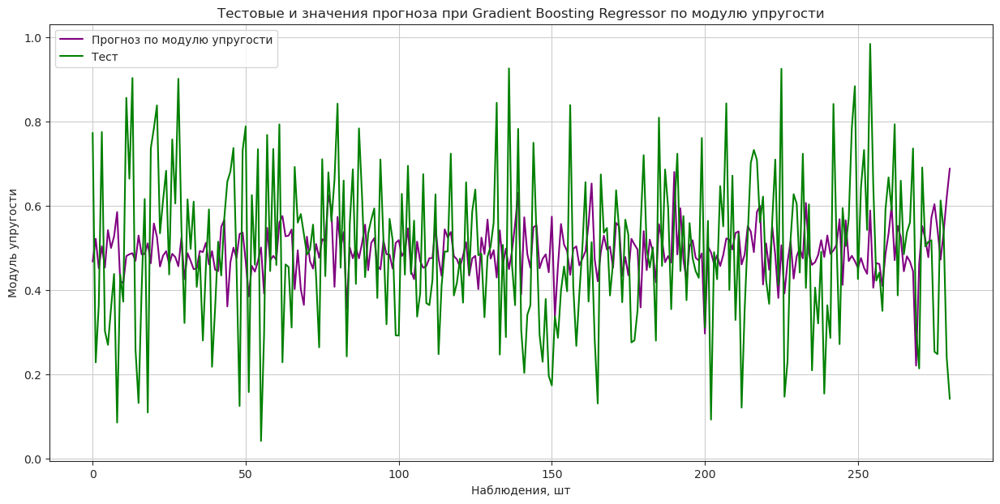

In [76]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Gradient Boosting Regressor по модулю упругости")
plt.plot(y_modulus_pred, label="Прогноз по модулю упругости", color = 'purple')
plt.plot(y_test_modulus.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Модуль упругости")
plt.legend()
plt.grid(True);

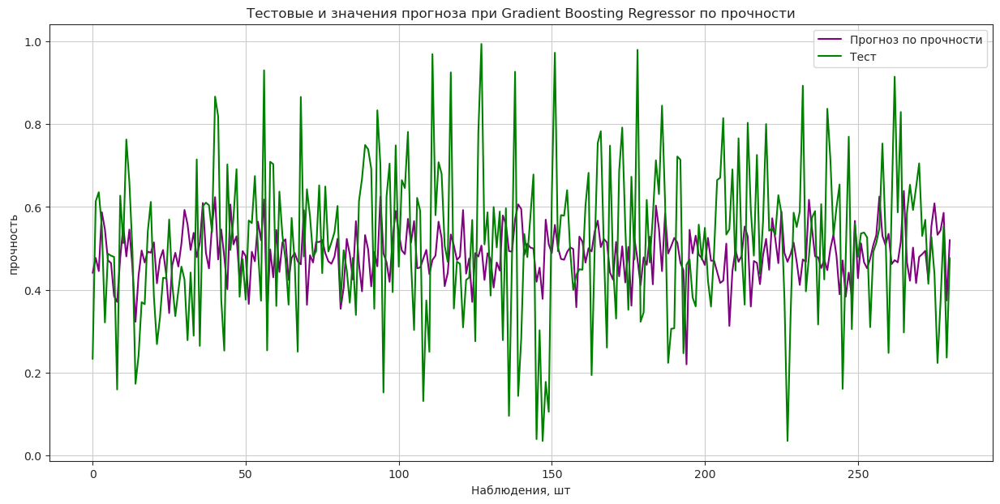

In [77]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Gradient Boosting Regressor по прочности")
plt.plot(y_strength_pred, label="Прогноз по прочности", color = 'purple')
plt.plot(y_strength1_test.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("прочность")
plt.legend()
plt.grid(True);

Данная модель тоже не подходит

## Метод опорных векторов - Support Vector Regression 

In [78]:
svr = make_pipeline(StandardScaler(), SVR(kernel = 'rbf', C = 500.0, epsilon = 1.0))

In [79]:
# Разделение данных на обучающую и тестовую выборки
X = dataset_norm_df[features]
y_modulus = dataset_norm_df[target_modulus]
y_strength = dataset_norm_df[target_strength]

X_train, X_test, y_svrmodulus_train, y_svrmodulus_test = train_test_split(X, y_modulus, test_size=0.3, random_state=42)
X_train, X_test, y_svrstrength_train, y_svrstrength_test = train_test_split(X, y_strength, test_size=0.3, random_state=42)

In [80]:
# Обучение модели для прочности при растяжении
svr_strength = SVR(kernel = 'rbf', C = 500.0, epsilon = 1.0)
svr_strength.fit(X_train, y_svrstrength_train)
# Обучение модели для модуля упругости при растяжении
svr_modulus = SVR(kernel = 'rbf', C = 500.0, epsilon = 1.0)
svr_modulus.fit(X_train, np.ravel(y_svrmodulus_train))

SVR(C=500.0, epsilon=1.0)

In [81]:
# Предсказания для тестовой выборки
y_svrmodulus_pred = svr_modulus.predict(X_test)
y_svrstrength_pred = svr_strength.predict(X_test)

In [82]:
# Оценка качества модели для модуля упругости при растяжении
mae_svr = mean_absolute_error(y_svrmodulus_test, y_svrmodulus_pred)
mse_svr = mean_squared_error(y_svrmodulus_test, y_svrmodulus_pred)
r2_svr = r2_score(y_svrmodulus_test, y_svrmodulus_pred)

print(f"Модуль упругости при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_svr:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_svr:.2f}")
print(f"Коэффициент детерминации (R²): {r2_svr:.2f}")

Модуль упругости при растяжении:
Средняя абсолютная ошибка (MAE): 0.15
Среднеквадратичная ошибка (MSE): 0.03
Коэффициент детерминации (R²): -0.00


In [83]:
# Оценка качества модели для прочности при растяжении
mae_svr1 = mean_absolute_error(y_svrstrength_test, y_svrstrength_pred)
mse_svr1 = mean_squared_error(y_svrstrength_test, y_svrstrength_pred)
r2_svr1 = r2_score(y_svrstrength_test, y_svrstrength_pred)

print(f"Модуль прочности при растяжении:")
print(f"Средняя абсолютная ошибка (MAE): {mae_svr1:.2f}")
print(f"Среднеквадратичная ошибка (MSE): {mse_svr1:.2f}")
print(f"Коэффициент детерминации (R²): {r2_svr1:.2f}")

Модуль прочности при растяжении:
Средняя абсолютная ошибка (MAE): 0.15
Среднеквадратичная ошибка (MSE): 0.03
Коэффициент детерминации (R²): -0.01


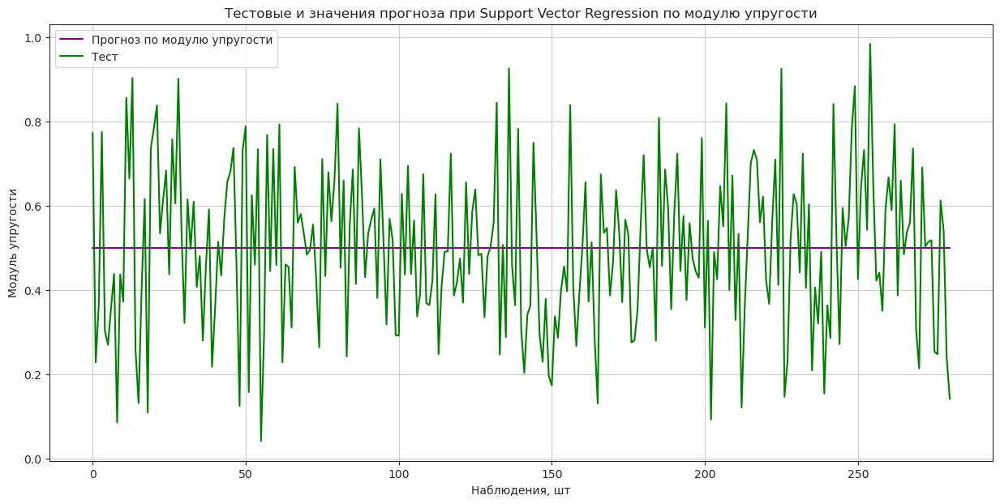

In [84]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Support Vector Regression по модулю упругости")
plt.plot(y_svrmodulus_pred , label="Прогноз по модулю упругости", color = 'purple')
plt.plot(y_svrmodulus_test.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Модуль упругости")
plt.legend()
plt.grid(True);

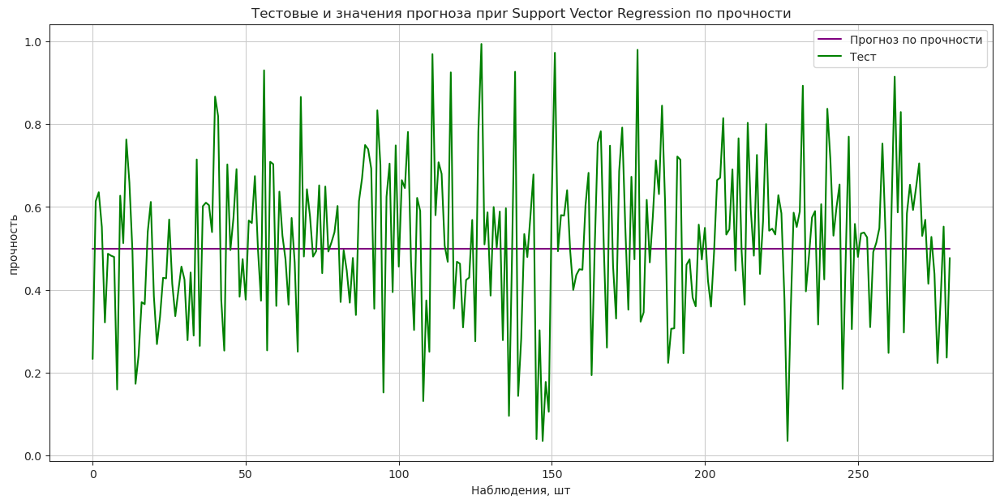

In [85]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза приr Support Vector Regression по прочности")
plt.plot(y_svrstrength_pred , label="Прогноз по прочности", color = 'purple')
plt.plot(y_svrstrength_test.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("прочность")
plt.legend()
plt.grid(True);

## Метод К ближайших соседей - K Neighbors Regressor 

In [86]:
features = [
    'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'Количество отвердителя, м.%',
    'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
    'Потребление смолы, г/м2', 'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки'
]
target_modulus = 'Модуль упругости при растяжении, ГПа'
target_strength = 'Прочность при растяжении, МПа'

X = dataset_norm_df[features]
y_modulus = dataset_norm_df[target_modulus]
y_strength = dataset_norm_df[target_strength]

# Разделение на обучающую и тестовую выборки
X_train, X_test, y_train_modulus, y_test_modulus = train_test_split(X, y_modulus, test_size=0.2, random_state=42)
X_train, X_test, y_train_strength, y_test_strength = train_test_split(X, y_strength, test_size=0.2, random_state=42)

# Обучение модели K ближайших соседей для модуля упругости при растяжении
knn_modulus = KNeighborsRegressor(n_neighbors=5)
knn_modulus.fit(X_train, y_train_modulus)

# Предсказание и оценка качества модели
y_pred_modulus = knn_modulus.predict(X_test)
mse_k = mean_squared_error(y_test_modulus, y_pred_modulus)
r2_k = r2_score(y_test_modulus, y_pred_modulus)

# Обучение модели K ближайших соседей для прочности при растяжении
knn_strength = KNeighborsRegressor(n_neighbors=5)
knn_strength.fit(X_train, y_train_strength)

# Предсказание и оценка качества модели
y_pred_strength = knn_strength.predict(X_test)
mse_k2 = mean_squared_error(y_test_strength, y_pred_strength)
r2_k2 = r2_score(y_test_strength, y_pred_strength)

print(f"Модуль упругости при растяжении:")
print(f"Среднеквадратичная ошибка (MSE): {mse_k:.2f}")
print(f"Коэффициент детерминации (R²): {r2_k:.2f}")

print(f"\nПрочность при растяжении:")
print(f"Среднеквадратичная ошибка (MSE): {mse_k2:.2f}")
print(f"Коэффициент детерминации (R²): {r2_k2:.2f}")


Модуль упругости при растяжении:
Среднеквадратичная ошибка (MSE): 0.04
Коэффициент детерминации (R²): -0.27

Прочность при растяжении:
Среднеквадратичная ошибка (MSE): 0.05
Коэффициент детерминации (R²): -0.27


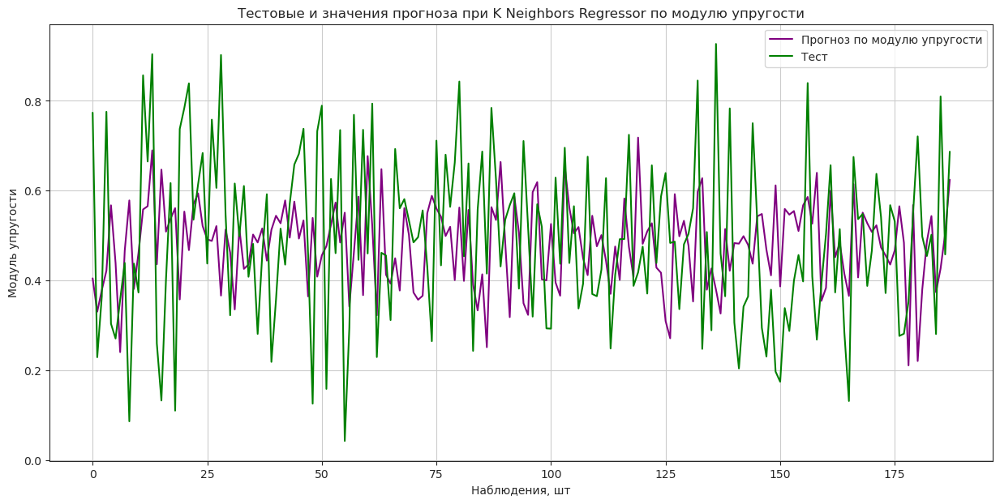

In [87]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при K Neighbors Regressor по модулю упругости")
plt.plot(y_pred_modulus, label="Прогноз по модулю упругости", color = 'purple')
plt.plot(y_test_modulus.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Модуль упругости")
plt.legend()
plt.grid(True);

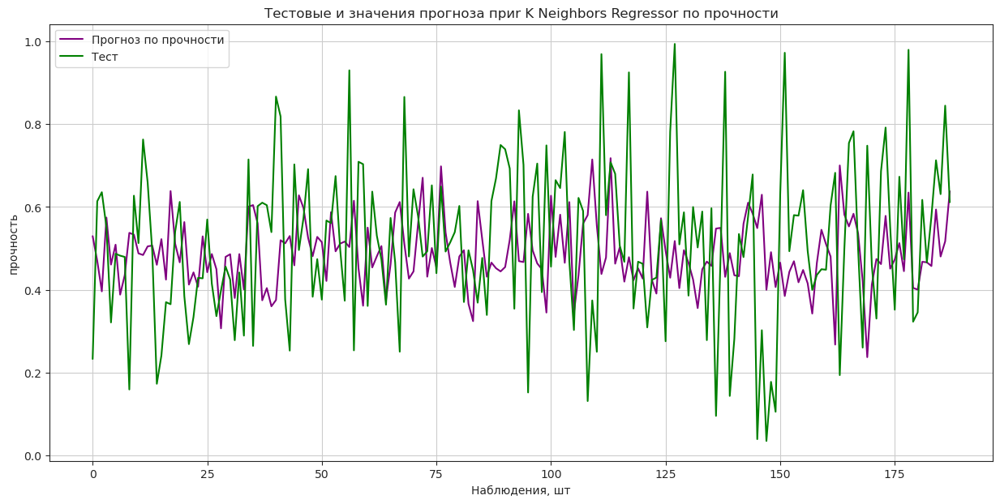

In [88]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза приr K Neighbors Regressor по прочности")
plt.plot(y_pred_strength, label="Прогноз по прочности", color = 'purple')
plt.plot(y_test_strength.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("прочность")
plt.legend()
plt.grid(True);

## Метод кросс валидации

In [89]:
# Определение признаков и целевых переменных
features = [
    'Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'Количество отвердителя, м.%',
    'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2', 'Поверхностная плотность, г/м2',
    'Потребление смолы, г/м2', 'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки'
]
target_modulus = 'Модуль упругости при растяжении, ГПа'
target_strength = 'Прочность при растяжении, МПа'

X = dataset_norm_df[features]
y_modulus = dataset_norm_df[target_modulus]
y_strength = dataset_norm_df[target_strength]

# Разделение на обучающую и тестовую выборки
X_train, X_test, y_train_modulus, y_test_modulus = train_test_split(X, y_modulus, test_size=0.2, random_state=42)
X_train, X_test, y_train_strength, y_test_strength = train_test_split(X, y_strength, test_size=0.2, random_state=42)

# Обучение модели K ближайших соседей для модуля упругости при растяжении с кросс-валидацией
knn_modulus = KNeighborsRegressor(n_neighbors=5)
cv_scores_modulus = cross_val_score(knn_modulus, X_train, y_train_modulus, cv=5, scoring='r2')

print(f"Кросс-валидация R² для модуля упругости: {cv_scores_modulus}")
print(f"Средний R² для модуля упругости: {cv_scores_modulus.mean():.3f}")

# Обучение модели K ближайших соседей для прочности при растяжении с кросс-валидацией
knn_strength = KNeighborsRegressor(n_neighbors=5)
cv_scores_strength = cross_val_score(knn_strength, X_train, y_train_strength, cv=5, scoring='r2')

print(f"Кросс-валидация R² для прочности при растяжении: {cv_scores_strength}")
print(f"Средний R² для прочности при растяжении: {cv_scores_strength.mean():.3f}")

# Финальное обучение на всем обучающем наборе и оценка на тестовом наборе
knn_modulus.fit(X_train, y_train_modulus)
y_pred_modulus = knn_modulus.predict(X_test)
mse_c = mean_squared_error(y_test_modulus, y_pred_modulus)
r2_c = r2_score(y_test_modulus, y_pred_modulus)

print(f"Тестовая выборка - Модуль упругости при растяжении - MSE: {mse_c:.2f}, R²: {r2_c:.2f}")

knn_strength.fit(X_train, y_train_strength)
y_pred_strength = knn_strength.predict(X_test)
mse_c2 = mean_squared_error(y_test_strength, y_pred_strength)
r2_c2 = r2_score(y_test_strength, y_pred_strength)

print(f"Тестовая выборка - Прочность при растяжении - MSE: {mse_c2:.2f}, R²: {r2_c2:.2f}")

Кросс-валидация R² для модуля упругости: [-0.1611993  -0.14702474 -0.1989337  -0.33261518 -0.12912389]
Средний R² для модуля упругости: -0.194
Кросс-валидация R² для прочности при растяжении: [-0.19265722 -0.27405195 -0.09954697 -0.1877608  -0.16004019]
Средний R² для прочности при растяжении: -0.183
Тестовая выборка - Модуль упругости при растяжении - MSE: 0.04, R²: -0.27
Тестовая выборка - Прочность при растяжении - MSE: 0.05, R²: -0.27


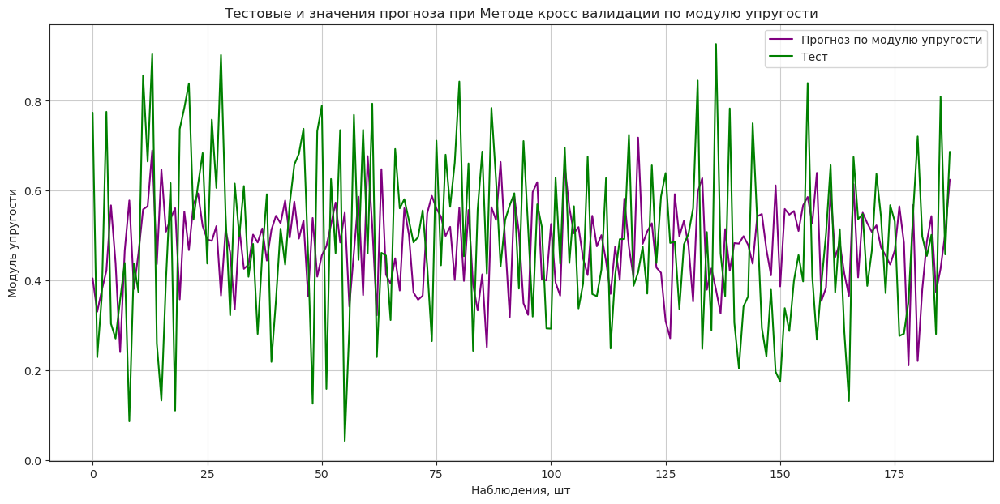

In [90]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза при Методе кросс валидации по модулю упругости")
plt.plot(y_pred_modulus, label="Прогноз по модулю упругости", color = 'purple')
plt.plot(y_test_modulus.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("Модуль упругости")
plt.legend()
plt.grid(True);

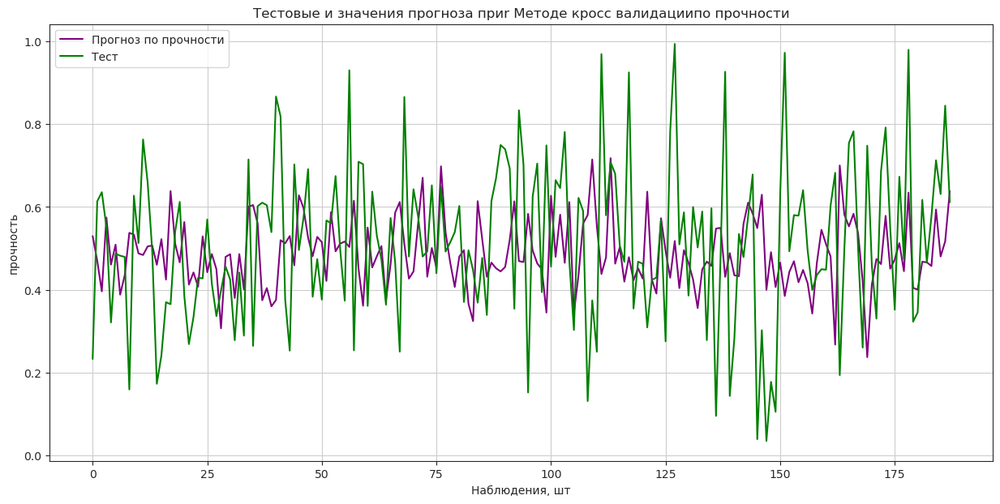

In [91]:
plt.figure(figsize = (15, 7))
plt.title("Тестовые и значения прогноза приr Методе кросс валидациипо прочности")
plt.plot(y_pred_strength, label="Прогноз по прочности", color = 'purple')
plt.plot(y_test_strength.values, label = "Тест", color = 'green')
plt.xlabel("Наблюдения, шт")
plt.ylabel("прочность")
plt.legend()
plt.grid(True);

# Поиск оптимальных гиперпараметров.

Гиперпараметры - параметры алгоритмов, значения которых устанавливаются перед запуском процесса обучения.Используются для управления процессом обучения.
Заставляют компьютер попробовать все возможные комбинации значений параметров.
метод GridSearch:
  - ПЛЮСЫ: Этот метод получит требуемые оптимальные гиперпараметры.
  - МИНУСЫ: Операция является исчерпывающей. Если диапазон или число гиперпараметров велики, то на завершение обучения потребуется много времени.

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import r2_score

# Определяем модели и гиперпараметры для подбора
# Мы будем использовать три модели: линейную регрессию, случайный лес и градиентный бустинг.
# Для каждой модели задаются гиперпараметры, которые будут подбираться с помощью GridSearchCV.
models = {
    "Linear Regression": {
        "model": LinearRegression(),
        "params": {
            "fit_intercept": [True, False],  # Подбираем параметр: учитывать ли перехват
            "positive": [True, False],       # Подбираем параметр: ограничивать ли коэффициенты положительными значениями
        },
    },
    "Random Forest": {
        "model": RandomForestRegressor(random_state=42),
        "params": {
            "n_estimators": [50, 100, 200],  # Количество деревьев в лесу
            "max_depth": [None, 10, 20],     # Максимальная глубина дерева
            "min_samples_split": [2, 5, 10], # Минимальное количество образцов для разбиения узла
        },
    },
    "Gradient Boosting": {
        "model": GradientBoostingRegressor(random_state=42),
        "params": {
            "n_estimators": [50, 100, 200],  # Количество деревьев
            "learning_rate": [0.01, 0.1, 0.5],  # Темп обучения (шаг градиентного спуска)
            "max_depth": [3, 5, 7],          # Максимальная глубина дерева
        },
    },
}

# Функция для обучения и оценки моделей
# Эта функция выполняет подбор гиперпараметров для заданной модели с использованием GridSearchCV,
# обучает модель на тренировочных данных и оценивает её на тестовых данных по метрике R2.
def train_and_evaluate(X_train, y_train, X_test, y_test, model, params):
    # Создание объекта GridSearchCV для подбора гиперпараметров
    # cv=10 означает, что будет использоваться 10-кратная кросс-валидация.
    # scoring='r2' означает, что оценка будет проводиться по метрике R2.
    grid_search = GridSearchCV(model, params, cv=10, scoring='r2', n_jobs=-1)
    
    # Обучение модели на тренировочных данных
    grid_search.fit(X_train, y_train)
    
    # Извлечение лучшей модели с оптимальными гиперпараметрами
    best_model = grid_search.best_estimator_
    
    # Прогнозирование на тестовых данных
    y_pred = best_model.predict(X_test)
    
    # Вычисление коэффициента детерминации (R2) на тестовых данных
    r2 = r2_score(y_test, y_pred)
    
    return best_model, r2

# Обучение моделей для прогнозирования модуля упругости
# Будем обучать и подбирать гиперпараметры для каждой модели, а также сохранять лучшую модель и её R2.
best_models_modulus = {}
r2_scores_modulus = {}

# Цикл по всем моделям, определённым в словаре models
for model_name, model_info in models.items():
    # Вызов функции train_and_evaluate для обучения модели и оценки её качества
    best_model, r2_score_modulus = train_and_evaluate(
        X_train_modulus_strength, y_train_modulus, 
        X_test_modulus_strength, y_test_modulus, 
        model_info["model"], model_info["params"]
    )
    
    # Сохранение лучшей модели для данной задачи
    best_models_modulus[model_name] = best_model
    
    # Сохранение значения R2 для данной модели
    r2_scores_modulus[model_name] = r2_score_modulus

# Вывод результатов R2 для каждой модели
print("R2 scores for Modulus Prediction:\n", r2_scores_modulus)

# Построение нейросети

In [97]:
# Определяем признаки и целевую переменную
features = [
    'Угол нашивки, град', 
    'Шаг нашивки', 
    'Плотность нашивки',
    'Соотношение матрица-наполнитель', 
    'Плотность, кг/м3', 
    'модуль упругости, ГПа',                                 
    'Количество отвердителя, м.%', 
    'Содержание эпоксидных групп,%_2',                       
    'Температура вспышки, С_2', 
    'Поверхностная плотность, г/м2',                             
    'Модуль упругости при растяжении, ГПа', 
    'Прочность при растяжении, МПа',                              
    'Потребление смолы, г/м2'
]

target = 'Соотношение матрица-наполнитель'

In [98]:
# Разделяем данные на обучающую и тестовую выборки
X = dataset_norm_df[features]
y = dataset_norm_df[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [99]:
# Создаем модель нейронной сети
model = Sequential()
model.add(Dense(64, input_dim=len(features), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1))

In [100]:
# Компилируем модель
model.compile(optimizer='adam', loss='mean_squared_error')

In [101]:
# Обучаем модель
model.fit(X_train, y_train, epochs=100, batch_size=10, validation_split=0.1)

Epoch 1/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.1671 - val_loss: 0.0155
Epoch 2/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 590us/step - loss: 0.0156 - val_loss: 0.0033
Epoch 3/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 610us/step - loss: 0.0039 - val_loss: 8.6000e-04
Epoch 4/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 546us/step - loss: 0.0010 - val_loss: 4.5420e-04
Epoch 5/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 5.5092e-04 - val_loss: 4.2370e-04
Epoch 6/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 3.6748e-04 - val_loss: 3.5663e-04
Epoch 7/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 569us/step - loss: 3.6738e-04 - val_loss: 2.6160e-04
Epoch 8/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 2.7440e-04 - val_loss: 2.4102e-04
Epoch 9/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 523us/step - loss: 2.7027e-04 - val_loss: 2.3743e-04
Epoch 10/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 476us/step - loss: 1.8915e-04 - val_loss: 2.2152e-04
Epoch 11/100
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 472us/step - loss: 2.2761e-04 - 

In [337]:
# Оцениваем модель
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 663us/step - loss: 1.4252e-05
Test Loss: 9.390953891852405e-06


## Консольное приложение для предсказания

In [ ]:
# Загрузка ранее сохраненной модели и scaler
# model.h5 содержит обученную нейронную сеть, а scaler.pkl - объект для нормализации данных.
model = load_model('/kaggle/working/model.h5')
scaler = joblib.load('/kaggle/working/scaler.pkl')

# Функция для предсказания соотношения матрица-наполнитель
def predict_matrix_ratio(input_features):
    # Преобразование входных данных в массив NumPy и изменение формы массива
    # reshape(1, -1) преобразует массив в форму, подходящую для модели (одна строка и нужное количество столбцов).
    input_array = np.array(input_features).reshape(1, -1)
    
    # Нормализация входных данных с использованием загруженного scaler
    input_scaled = scaler.transform(input_array)
    
    # Предсказание с использованием загруженной модели
    prediction = model.predict(input_scaled)
    
    # Возвращаем предсказанное значение
    return prediction[0][0]

# Консольное приложение для взаимодействия с пользователем
def console_app():
    print("Введите значения для следующих параметров:")
    
    # Список признаков, которые пользователь должен ввести
    feature_names = [
        "Угол нашивки, град", 
        "Шаг нашивки", 
        "Плотность нашивки", 
        "Плотность, кг/м3", 
        "Модуль упругости, ГПа", 
        "Количество отвердителя, м.%", 
        "Содержание эпоксидных групп,%_2", 
        "Температура вспышки, С_2", 
        "Поверхностная плотность, г/м2", 
        "Модуль упругости при растяжении, ГПа", 
        "Прочность при растяжении, МПа", 
        "Потребление смолы, г/м2"
    ]
    
    input_features = []
    
    # Запрашиваем значения для каждого признака у пользователя
    for feature in feature_names:
        value = input(f"{feature} (оставьте пустым, если нет данных): ")
        if value == "":
            value = 0.0  # Если пользователь оставил поле пустым, используем значение по умолчанию 0.0
        input_features.append(float(value))
    
    # Предсказание соотношения матрица-наполнитель
    predicted_ratio = predict_matrix_ratio(input_features)
    
    # Вывод результата предсказания
    print(f"\nПредсказанное соотношение матрица-наполнитель: {predicted_ratio:.4f}")

# Запуск консольного приложения
if __name__ == "__main__":
    console_app()